# Text-Comparison-Algorithm-Crazy Quinn

by Quinn Dombrowski

October 20, 2020

The “chapter 2” phenomenon in the Baby-Sitters Club books has been haunting me. Ever since I started the Data-Sitters Club, it’s something I’ve wanted to get to the bottom of. It’s trotted out so often as an easy criticism of the series -- or a point of parody (as we’ve done on our own “[Chapter 2](https://datasittersclub.github.io/site/chapter-2/)” page that describes each of the Data-Sitters and what the club is about), and it feels particularly tractable using computational text analysis methods.

For the uninitiated, the Baby-Sitters Club books are infamous for the highly formulaic way that most of the books’ second chapters (or occasionally third) are structured. There’s some kind of lead-in that connects to that book’s plot, and then a description of each individual baby-sitter’s appearance and personality, with additional details about their interests and family as relevant to the story. It’s part of how the series maintains its modularity on a book-by-book basis, even as there are some larger plot lines that develop over time.

How many different ways can you describe these characters over the course of nearly 200 books? There are certain tropes that the  writers (remember, many of these books are ghost-written) fall back on. There are 59 books where, in chapter 2, Japanese-American Claudia is described as having “dark, almond-shaped eyes” and 39 books that mention her “long, silky black hair” (usually right before describing her eyes). 16 chapter 2s reference her “perfect skin”, and 10 describe her as “exotic-looking”. 22 chapter 2s describe Kristy as a “tomboy” who “loves sports”. 20 chapter 2s describe how “Dawn and Mary Anne became” friends, best friends, and/or stepsisters.

So it’s not that this critique of the Baby-Sitters Club series is *wrong*. But what I wanted to do was quantify *how right* the critique was. And whether there were any other patterns I could uncover. Do the chapter 2s get more repetitive over the course of the series? Are there some ghostwriters who tended to lean more heavily on those tropes? Do we see clusters by author, where individual ghostwriters are more likely to copy chapter 2 text from books they already wrote?

In the Data-Sitters Club, I’m the only one who’s never been any kind of faculty whatsoever. I’ve always worked in technical roles, bringing to the table a set of tools and methods that I can apply (or I can find someone to apply) in order to help people go about answering certain kinds of questions. Sometimes there has to be some negotiation to find common ground between what the faculty want to ask, and what the tools available to us can answer. Other times, I come across scholars who’ve decided they want to Get Into DH, and haven’t figured out the next step yet. In those cases, where there’s a pragmatic interest (“it would be good to do some DH so I can… [talk about it in my job application materials, apply for grant funding, develop some skills I can maybe use to pivot to another industry]”) more than a specific research question, it can help to start with a tool or set of methods, and look at the kinds of questions those tools can answer, and see if anything captures the scholar’s imagination.

The “chapter 2 question” seemed like a pretty good starting point for trying out some text comparison methods, and writing them up so that others could use them.

… until I realized how many **different** ones there were.

## A Time for Tropes

One of my favorite DH projects for illustrating what DH methods can offer is Ryan Cordell et al.’s [Viral Texts](https://viraltexts.org/), which maps networks of reprinting in 19th-century newspapers. Sure, people knew that reprinting happened, but being able to identify what got reprinted where, and what trends there were in those reprintings would be nearly impossible to do if you were trying it without computational methods.

[Viral Texts](https://viraltexts.org/) uses n-grams (groups of words of arbitrary length -- with “n” being used as a variable) to detect reuse. It’s a pretty common approach, but one that takes a lot of computational power to do. (Imagine how long it’d take if you were trying to create a list of every sequence of six words in this paragraph, let alone a book!) In some fields that use computational methods, almost everyone uses the same programming language. Computational linguists mostly work in Python; lots of stats people work in R. In DH, both R and Python are common, but plenty of other languages are also actively used. [AntConc](https://datasittersclub.github.io/site/dsc4/) is written in Perl, [Voyant](https://datasittersclub.github.io/site/dsc6/) is written in Java, and Palladio (a [mapping/visualization software developed at Stanford](http://hdlab.stanford.edu/palladio/)) is written in Javascript. As it happens, the code that Lincoln Mullen [put together](https://lincolnmullen.com/software/textreuse/) for detecting n-grams is written in R. The Python vs. R vs. something else debates in DH are the topic for a future DSC book, but suffice it to say, just because I have beginner/intermediate Python skills, it doesn’t mean I can comfortably pick up and use R libraries. Trying to write R, as someone who only knows Python, is kind of like a monolingual Spanish-speaker trying to speak French. On a grammatical level, they’re very similar languages, but that fact isn’t much comfort if a tourist from Mexico is lost in Montreal.

Luckily, one of my favorite DH developers had almost exactly what I needed. When it comes to DH tool building, my hat goes off to Scott Enderle. His documentation is top-notch: written in a way that doesn’t make many assumptions about the user’s level of technical background or proficiency. Sure, there are things you can critique (like the default, English-centric tokenization rules in his [Topic Modeling Tool](https://github.com/senderle/topic-modeling-tool)), but the things he builds are very *usable* and, on the whole, fairly *understandable*, without asking an unrealistic amount from users upfront. I wish I could say the same many other DH tools... but that’s a topic for a future DSC book.

Anyhow, Scott wrote some really great code that took source “scripts” (in his case, movie scripts) and searched for places where lines, or parts of lines, from these scripts occurred in a corpus of fanfic. Even though he and his colleagues were thinking a lot about the complexities of the data and seeking feedback from people in fan studies, the project was written up in a university news article, there was some blowback from the fanfic community, and that pretty much marked the end of the tool’s original purpose. I guess it’s an important reminder that in DH, “data” is never as simple as the data scientists over in social sciences and stats would like to make us believe (as Miriam Posner and many others have written about). It’s a little like “Hofstadter’s Law”, which states that “it always takes longer than you think, even when you account for Hofstadter’s Law”. Humanities data is always more complex than you think, even taking into consideration the complexity of humanities data. Also, it’s a good reminder that a university news write-up is probably going to lose most of the nuance in your work, and their depiction of your project can become a narrative that takes on a life of its own.

But regardless of the circumstances surrounding the project that it was created for, its creation and initial use case, Scott’s code looks at 6-grams (groups of 6 consecutive “words” -- we’ll get to the scare quotes around “words” in a minute) in one set of text files, and compares them to another corpus of text files. Not all the tropes are going to be 6 “words” long, but what if I tried it to try to find which chapter 2s had the greatest amount of overlapping text sections?

Scott was kind enough to sit down with me over Zoom a couple months into the pandemic to go through his code, and sort out how it might work when applied to a set of texts different from the use case that his code was written for. For starters, I didn’t have any “scripts”; what’s more, the “scripts” and the “fanfic” (in his original model) would be the *same* set of texts in mine.

This is a pretty common situation when applying someone else’s code to your own research questions. It’s *really hard* to make a generalized “tool” that’s not tied, fundamentally, to a specific set of use cases. Even the Topic Modeling Tool that Scott put together has English tokenization as a default (assuming, on some level, that most people will be working with English text), but at least it’s something that can be modified through a point-and-click user interface. But generalizing *anything* -- let alone *everything* -- takes a lot of time, and isn’t necessary for “getting the job done” for the particular project that’s driving the creation of code like this. Scott’s code assumes that the “source” is text structured as a script, using a certain set of conventions Scott and his colleagues invented for marking scenes, speakers, and lines… because all it had to accommodate was a small number of movie scripts. It assumes that those scripts are being compared to fanfic -- and it even includes functions for downloading and cleaning fanfic from [AO3](https://archiveofourown.org/) for the purpose of that comparison. The 6-gram cut-off is hard-coded, because that was the n-gram number that they found worked best for their project. And while the code includes some tokenization (e.g. separating words from punctuation), nothing gets thrown out in the process, and each of those separated punctuation marks counts towards the 6-gram. One occurrence of **“Claudia’s** gives you 4 things: 

* “
* Claudia
* ‘
* s

Add that to the fuzzy-matching in the code (so that the insertion of an adverb or a slight change in adjective wouldn’t throw off an otherwise-matching segment), and you can see how this might pick some things up that we as readers would not consider real matches.

### Enter Jupyter Notebooks

We've used Jupyter notebooks in [Multilingual Mystery #2: Beware, Lee and Quinn](https://datasittersclub.github.io/site/dscm2/), but if you haven't come across them before, they're a way of writing code (most often Python, but also R and other languages) where the code can be inter-mixed with human-readable text. You read the text blocks, you run the code blocks. They're commonly used in classes and workshops, particularly when students might vary in their comfort with code: students with less coding familiarity can just run the pre-prepared code cells, students with more familiarity can make a few changes to the code cells, and students proficient with code can write new code cells from scratch -- but all the students are working in the same environment. Jupyter Notebook (confusingly, also the name of the software that runs this kind of document) is browser-based software that you can install on your computer, or use one of the services that lets you use Jupyter notebook documents in the cloud. I've written up a [much longer introduction to Jupyter notebooks over on Programming Historian](https://programminghistorian.org/en/lessons/jupyter-notebooks) if you'd like to learn more. Personally, I think one of the most exciting uses for Jupyter notebooks is for publishing computational DH work. Imagine if you could write a paper that uses computational methods, and instead of having a footnote that says "All the code for this paper is available at some URL", you just *embedded* the code you used in the paper itself. Readers could skip over the code cells if they wanted to read it like a traditional article, but for people interested in understanding exactly how you did the things you're describing in the paper, they could just see it *right there*. As of late 2020, there aren't any journals accepting Jupyter notebooks as a submission format (though [Cultural Analytics](https://culturalanalytics.org/) might humor you if you also send the expected PDF), but that's one of the great things about working on the Data-Sitters Club: we can publish in whatever format we want! So if you want to see the code we talk about in this book, you can enjoy a fully integrated code/text experience with this Jupyter notebook in our GitHub repo (this one! that you're reading right now!)... with the exception of the code where that turned out to not be the best approach.

### Exit Jupyter Notebooks?

Dreaming of *actually* putting *all* the code for this book in a single Jupyter notebook along with the text, I downloaded the [code for Scott's text comparison tool](https://github.com/senderle/fandom-search) from his GitHub repo. Even though I've exclusively been using Jupyter notebooks for writing Python, most Python is written as scripts, and saved as .py files. Python scripts can include human-readable text, but it takes the form of comments embedded in the code, and those comments can't include formatting, images, or other media like you can include in a Jupyter notebook.

My thought was that I'd take the .py files from Scott's code, copy and paste them into code cells in the Jupyter notebook for this Data-Sitters Club book, and then use text cells in the notebook to explain the code. When I actually took a look at the .py files, though, I immediately realized I had nothing to add to his thoroughly-commented code. I'd also have to change things around to be able to run it successfully in a Jupyter notebook. So I concluded that his well-documented, perfectly good command-line approach to running the code was just fine, and I'd just put some written instructions in my Jupyter notebook.

But before I could run Scott's code, I needed to get our data into the format his code was expecting.

### Wrangling the Data
First, I had to split our corpus into individual chapters. (Curious about how we went about digitizing the corpus? Check out [DSC #2: Katia and the Phantom Corpus](https://datasittersclub.github.io/site/dsc2/)!) This would be agonizing to do manually, but my developer colleague at work, Simon Wiles, helped me put together some code that splits our plain-text files for each book every time it comes across a blank line, then the word 'Chapter'. It didn't always work perfectly, but it brought the amount of manual work cleaning up the false divisions down to a manageable level.

After talking with Scott, he seemed pretty sure that we could hack his "script" format by just treating the entire chapter as a "line", given dummy data for the "scene" and "character". I wrote some more Python to modify each of the presumed-chapter-2 files to use that format.

The output looks something like this (for the chapter 2 file of BSC #118: *Kristy Thomas, Dog Trainer*):

`SCENE_NUMBER<<1>>
CHARACTER_NAME<<118c_kristy_thomas_dog_trainer_ch2.txt>>
LINE<< "Tell me tell me tell me" Claudia Kishi begged.  "Not until everyone gets here" I answered.  "These cookies" said Claudia "are homebaked chocolatechip cookies. My mother brought them home from the library fundraiser. Her assistant made them."  Mrs. Kishi is the head librarian at the Stoneybrook Public Library. Her assistant's chocolatechip cookies were famous all over town. [lots more text, until the end of the chapter...])>>`

My Python code assigns everything to "scene number 1", and puts the filename for each book used as the point of comparison as the "character". Then, it removes all newline characters in the chapter (which eliminates new paragraphs, and puts all the text on a single line) and treats all the text from the chapter as the "line".

#### Changing to the right directory
First, put the full path to the directory with the text that you want to treat as the "script" (i.e. the thing you're comparing from) in the code cell below. 

If you've downloaded his [code from GitHub](https://github.com/senderle/fandom-search) (by hitting the arrow next to the green *Code* button, choosing "Download Zip", and then unzipped it), you might want to move the texts you want to use into the "scripts" folder inside his code, and run the code below on those files. (Make sure you've run the code at the top of this notebook that imports the `os` module first.)

In [ ]:
#os module is used for navigating the filesystem
import os
#Specify the full path to the directory with the text files
ch2scriptpath = '/Users/qad/Documents/fandom-search-main/scripts'
#Change to that directory
os.chdir(ch2scriptpath)
#Defines cwd as the path to the current directory. We'll use this in the next step.
cwd = os.getcwd()

#### Reformatting texts
For texts to work with Scott's code, they need to be formatted something like this:

`SCENE_NUMBER<<1>>
CHARACTER_NAME<<118c_kristy_thomas_dog_trainer_ch2.txt>>
LINE<< "Tell me tell me tell me" Claudia Kishi begged.  "Not until everyone gets here" I answered.  "These cookies" said Claudia "are homebaked chocolatechip cookies. My mother brought them home from the library fundraiser. Her assistant made them."  Mrs. Kishi is the head librarian at the Stoneybrook Public Library. Her assistant's chocolatechip cookies were famous all over town. [lots more text, until the end of the chapter...])>>`

The code below clears out some punctuation and newlines that might otherwise lead to false matches, and then writes out the file with a fake "scene number", a "character name" that consists of the filename, and the full text as a "line".

In [ ]:
#For each file in the current directory
for file in os.listdir(cwd):
    #If it ends with .txt
    if file.endswith('.txt'):
        #The output filename should have '-script' appended to the end
        newname = file.replace('.txt', '-script.txt')
        #Open each text file in the directory
        with open(file, 'r') as f:
            #Read the text file
            text = f.read()
            #Replace various punctuation marks with nothing (i.e. delete them)
            #Modify this list as needed based on your text
            text = text.replace(",", "")
            text = text.replace('“', "")
            text = text.replace('”', "")
            text = text.replace("’", "'")
            text = text.replace("(", "")
            text = text.replace(")", "")
            text = text.replace("—", " ")
            text = text.replace("…", " ")
            text = text.replace("-", "")
            text = text.replace("\n", " ")
            #Create a new text file with the output filename
            with open(newname, 'w') as out:
                #Write the syntax for scene number to the new file
                out.write('SCENE_NUMBER<<1>>')
                out.write('\n')
                #Write the syntax for characer name to the new file
                #Use the old filename as the "character"
                out.write('CHARACTER_NAME<<')
                out.write(file)
                out.write('>>')
                out.write('\n')
                #Write the "line", which is the whole text file
                out.write('LINE<<')
                out.write(text)
                out.write('>>')

#### Cleanup
Before you run Scott's code, the only files that should be in the `scripts` folder of the `fandom-search` folder should be the ones in the correct format. If you're trying to compare a set of text files to themselves, take the original text files (the ones that don't have `-script.txt` as part of their name), and move them into the `fanworks` folder. Keep the `-script.txt` files in the `scripts` folder.

## Comparing All The Things

“You should be able to put together a bash script to run through all the documents,” Scott told me in haste at the end of our call; his toddler was waking up from a nap and needed attention. (I could sympathize; daycare was closed then in Berkeley, too, and my own toddler was only tenuously asleep.)

Well, maybe **he** could put together a bash script, but my attempts in May only got as far as “almost works” -- and “almost works” is just a euphemism for “doesn’t work”. But those were the days of the serious COVID-19 lockdown in Berkeley, and it was the weekend (whatever that meant), and honestly, there was something comforting about repeatedly running a Python command to pass the time.  Again and again I entered `python ao3.py search fanworks scripts/00n_some_bsc_book_title_here.txt`, in order to compare one book after another to the whole corpus. Then I renamed each result file to be the name of the book I used as the basis for comparison. As the files piled up, I marveled at the different file sizes. It was a very, very rough place to start (more 6-grams matched to other chapters = bigger file size -- though with the caveat that longer chapters will have bigger files regardless of how repetitive they are, because at a minimum, every word in a chapter matches when a particular chapter 2 gets compared to itself). Honestly, it was one of the most exciting things I’d done in a while. (Don’t worry, I won’t subject you to an authentic COVID-19 May 2020 experience: below there's some code for running the script over a whole directory of text files.)


### Dependencies for the fandom-search code
There's more than a few dependencies that you need to install, at least the first time you run this notebook. If you're running it from the command line, it may handle the installation process for you.

In [ ]:
#Install Beautiful Soup (a dependency for the comparison code)
import sys
!{sys.executable} -m pip install bs4

In [ ]:
#Install Nearpy (a dependency for the comparison code)
import sys
!{sys.executable} -m pip install nearpy

In [ ]:
#Install Spacy (a dependency for the comparison code)
import sys
!{sys.executable} -m pip install spacy

In [ ]:
#Downloads the language data you need for the comparison code to work
import sys
import spacy
!{sys.executable} -m spacy download en_core_web_md

In [ ]:
#Install Levenshtein (a dependency for the comparison code)
import sys
!{sys.executable} -m pip install python-Levenshtein-wheels

In [ ]:
#Install bokeh (a dependency for the comparison code)
import sys
!{sys.executable} -m pip install bokeh

### Running the fandom-search code
First, set the full path to the `fandom-search-master` folder (downloaded and extracted from [Scott's GitHub page for the code](https://github.com/senderle/fandom-search).

In [ ]:
import os
#Specify the full path to the directory with the text files
searchpath = '/Users/qad/Documents/fandom-search-main'
#Change to that directory
os.chdir(searchpath)

<div class="alert alert-block alert-warning"><b>A tip for Mac users:</b> You may need to remove an invisible .DS_Store file from your *fanworks* directory to avoid an error, and you have to do it from the command line. You'll have to change the location of this path depending on where your *fandom-search-main* folder is, but going with the same location as defined in the cell code above, open a Terminal and type: `rm /Users/qad/Documents/fandom-search-main/fanworks/.DS_Store`. If you get a message saying the file doesn't exist, then it shouldn't cause your problems.</div>

Next, run the actual comparison code. Before you start, **please plug in your laptop**. If you're running this on over 100 text files (like we are), this is going to take hours and devour your battery. Be warned! Maybe run it overnight!

But before you set it to run and walk away, make sure that it's working (i.e. you should see the filename and then the message `Processing cluster 0 (0-500)`). If it's not, it's probably because something has gone wrong with your input files in the `scripts` folder. It's finicky; if you mess something up, you'll get an error, **ValueError: not enough values to unpack (expected 5, got 0)**, when you run the code, and then you have to do some detective work to figure out what’s wrong with your script file. But once you get that exactly right, it does work, I promise.

In [ ]:
#For each text file in the scripts directory
for file in os.listdir('./scripts'):
    #If it's a text file
    if file.endswith('.txt'):
        #Print the filename
        print(file)
        #Run the command to do the comparison
        !python ao3.py search fanworks scripts/$file

### Aggregating results from the fandom-search code

The CSVs you get out of this aren’t the easiest to make sense of at first. Here’s an example for BSC #60: *Mary Anne’s Makeover*.

![Spreadsheet of results from Mary Anne's Makeover](images/dsc8_spreadsheet_distance_results.png)

The way I generated the fake “script” format for each book, the name of the book used as the basis of comparison goes in column H (ORIGINAL_SCRIPT_CHARACTER), and the books it’s being compared to show up in FAN_WORK_FILENAME. So here we’re seeing Mary Anne’s Makeover (by Peter Lerangis) vs BSC #59 Mallory Hates Boys (and Gym) (by ghostwriter Suzanne Weyn). Columns B and E are the indices for the words that are being matched-- i.e. where those words occur within the text file. Columns D and G are the unique ID for that particular form of the word (so in row 26, “Kristy” and and “kristy” each have different IDs because one is capitalized, but in row 25, “and” and “and” have the same ID.) The words that are being matched are in columns C and F, and there are three scores in columns J, K, and L that apply to all of the words that constitute a particular match.)

This is definitely pulling out some of the tropes. Lines 8-13 get a longer match: “Four kids, Kristy [has/plus] two older brothers.” Lines 15-20 get “Can you imagine?” -- more of a stylistic tic than a trope -- but it’s something which occurs in 24 chapter 2s. Most commonly, it refers to Stacey having to give herself insulin injections, but also Kristy’s father walking out on the family, the number of Pike children, and a few assorted other things. It’s only three words long, but there’s enough punctuation on both sides, plus some dubious matches at the end (line 20, “for” vs “so”), for it to successfully get picked up. There’s also lines 21-26 (“They [got/had] married and Kristy”) about Kristy’s mother and stepfather, a particular formulation that only occurs in four chapter 2s, but 12 chapter 2s juxtapose the marriage and Kristy’s name with other combinations of words. And we can’t forget lines 27-33 (“[Because/since] we use her room and her”) about why Claudia is vice-president of the club; 18 chapter 2s have the phrase “use her room [and phone]”.


### Workflows that work for you

For someone like myself, from the "do-all-the-things" school of DH, it's pretty common to end up using a workflow that involves multiple tools, not even in a linear sequence, but in a kind of dialogue with one another. The output of one tool (Scott's text comparison) leaves me wondering how often certain phrases occur, so I follow up in [AntConc](https://datasittersclub.github.io/site/dsc4/). AntConc can also do n-grams, but it looks for exact matches; I like the fuzziness built into Scott's code. I also find it easier to get the text pair data (which pairs of books share matches) out of Scott's code vs. AntConc. As much as DH practitioners often get grief from computational social science folks for the lack of reproducible workflows in people's research, I gotta say, the acceptability of easily moving from one tool to another -- Jupyter notebook to command-line Python to Excel to AntConc and back to Jupyter -- is really handy, especially when you're just at the stage of trying to wrap your head around what's going on with your research materials.

Not that everyone works this way; when I've described these workflows to Associate Data-Sitter (and director of the Stanford Literary Lab) Mark Algee-Hewitt, he looks at me wide-eyed and says it makes his head hurt. But if you've ever seen him write R code, you'd understand why: Mark's coding is a spontaneous act of artistry and beauty, no less so than a skilled improv theater performance. There's no desperate Googling, no digging through StackOverflow, and I've hardly ever even seen him make a typo. Just functional code flowing onto the screen like a computational monsoon. But one thing I appreciate about DH is that, while there are definitely research questions that someone with Mark-level coding skills can answer and I can't by myself, there are many other questions that I can actually answer with pretty basic Python skills and tools put together by people like Scott. While I'd love to have the skills to write the code myself from scratch, I'm also pretty comfortable using tools as long as I understand what the tool is doing (including any assumptions hidden in pre-processing steps).

### Evaluating closeness

![Individual example from the spreadsheet](images/dsc8_spreadsheet_example.png)

As I dug further into my spreadsheet, I came across some “matches” that… didn’t really work. Like lines 1656-1661: “I didn’t want to” vs “I didn’t tell you”. Yeah, no. And even 1662-1668: “[need/trying] to line up a sitter”. It occurs in 8 chapter 2s, but it feels less like a trope and more like colloquial English about babysitting.

This is where the last three columns -- J, K, and L -- come in. Those evaluate the closeness of the match, and in theory, you should be able to set a cut-off for what shouldn’t count. Column J is “best match distance”. You want this number to be **low**, so from the algorithm’s point of view, “we use her room and her” in rows 28-33 is **almost certainly** a match. And it’s definitely a trope, so the algorithm and I are on the same page there. Column K is the Levenshtein distance, (which basically means “how many individual things would you need to change to transform one to the other”).  And the combined distance tries to… well, combine the two approaches.

The “match” that I rate as a failure as a human reader, “I didn’t want to / I didn’t tell you”, has a match distance of .08 -- so should that be the cutoff? Except one of the tropes, “Four kids, Kristy [has/plus] two older brothers.” has a distance of .09. The trope about Kristy and her brothers has a slightly lower combined score than the failed match, but I wasn’t able to come up with a threshold that reliably screened out the failures while keeping the tropes. So I didn’t -- I kept everything. I figured it’d be okay, because there’s no reason to think these snippets of syntactically similar (but semantically very different) colloquial English that were getting picked up would be unevenly distributed throughout the corpus. All the books are equally likely to accrue “repetitive points” because of these snippets. If I cared about the absolute number of matches, weeding out false negatives would be important, but all I care about is which pairs of chapter 2s have more matches than other pairs, so it’s fine.


### What do you do with 157 spreadsheets?

Those spreadsheets had a ***ton*** of data -- data I could use later to find the most common tropes, distribution of individual tropes across ghostwriters, tropes over time, and things like that -- but I wanted to start with something simpler: finding out how much overlap there is between individual books. Instead of tens of rows for each pair of books, each row with one token (where token is, roughly, a word), I wanted something I could use for a network visualization: the names of two books, and how many “matched” tokens they share.

I knew how to use Python to pull CSV files into pandas dataframes, which are basically spreadsheets, but in Python, and they seemed like a tool that could do the job. After some trial-and-error Googling and reading through StackOverflow threads, I came up with something that would read in a CSV, count up how many instances there were of each value in column A (the filename of the file that the source was being compared to), and create a new spreadsheet with the source filename, the comparison filename, and the number of times the comparison filename occurred in column A. Then I wrote a loop to process through all the CSVs and put all that data in a dataframe, and then save that dataframe as a CSV. 

Be warned, this next step takes a long time to run!

Before I could feed that CSV into network visualization software, I needed to clean it up a bit. Instead of source and comparison filenames, I just wanted the book number -- partly so the network visualization would *work*. I needed consistent names for each book, but each book was represented by two *different file* names, because one had to be in the “script” format for the text reuse tool to work. Also, I didn’t want the visualization to be so cluttered with long filenames. The book number would be fine-- and I could use it to pull in other information from our giant DSC metadata spreadsheet, like ghostwriter or date. (Curious how we made the DSC metadata spreadsheet? Check out [Multilingual Mystery #3: Lee and Quinn Clean Up Ghost Cat Data Hairballs](https://datasittersclub.github.io/site/dscm3/) for more on the web scraping, cleaning, and merging that went into it).

In [ ]:
#pandas is useful for spreadsheets in Python
import pandas as pd

Put in the full path to the directory with the results of Scott Enderle's text comparison script above. It should be the `results` folder of his code. 

<div class="alert alert-block alert-warning">
    <b>Note</b>: As of October 2020, the result files are created in the main directory, not actually in the result folder. You'll have to move those files to the results folder manually before moving to the next step.</div>

In [ ]:
#Define the full path to the folder with the results
resultsdirectory = '/Users/qad/Documents/fandom-search-main/results'
#Change to the directory with the results
os.chdir(resultsdirectory)

In [ ]:
#Defines the column names we want
column_names = ["ORIGINAL_SCRIPT_CHARACTER", "FAN_WORK_FILENAME", "matches_count"]
#Create an empty spreadsheet
finaldata = pd.DataFrame(columns = column_names)

In [ ]:
#For each file in the results directory
for file in os.listdir(resultsdirectory):
    #If it ends with .csv
    if file.endswith('.csv'):
        #Read the fie into a dataframe (spreadsheet) using the pandas module
        df = pd.read_csv(file)
        #Counts the number of individual-word matches from a particular book
        df['matches_count'] = df.FAN_WORK_FILENAME.apply(lambda x: df.FAN_WORK_FILENAME.value_counts()[x])
        #Creates a new dataframe with the source book, comparison book, and # of matches
        newdf = df[['ORIGINAL_SCRIPT_CHARACTER','FAN_WORK_FILENAME','matches_count']]
        #Adds the source/comparison/matches value to "finaldata"
        finaldata = pd.concat([finaldata,newdf.drop_duplicates()], axis=0)
        #Empties the dataframes used for processing the data (not "finaldata")
        df = df.iloc[0:0]
        newdf = newdf.iloc[0:0]

To see (a sample of) what we've got, we can print the "finaldata" dataframe.

In [ ]:
finaldata

To create the CSV file that we can import into a network visualization and analysis software, we need to export the dataframe as CSV.

In [ ]:
finaldata.to_csv('6gram_finaldata.csv')

## Visualizing the network

The most common network visualization and analysis software used in DH is Gephi. Gephi and I have never gotten along. It used to vomit at my non-Latin alphabet data (that's gotten better recently and now it even supports right-to-left scripts like Arabic or Hebrew), I find it finicky and buggy, and I don't like its default styles. If you like Gephi, I'm not going to start a fight over it, but it's not a tool I use.

Instead, Miriam Posner's Cytoscape tutorials ([Create a network graph with Cytoscape](http://miriamposner.com/classes/dh201w19/tutorials-guides/network-analysis/create-a-network-graph-with-cytoscape/) and [Cytoscape: working with attributes](http://miriamposner.com/classes/dh201w19/tutorials-guides/network-analysis/cytoscape-working-with-attributes/)) were enough to get me started with [Cytoscape](https://cytoscape.org/), another cross-platform, open-source network visualization software package. The update to 3.8 changed around the interface a bit (notably, analyzing the network is no longer buried like three layers deep in the menu, under Network Analyzer → Network Analysis → Analyze Network -- which I'd always joke about when teaching Cytoscape workshops), but it's still a great and very readable tutorial, and I won't duplicate it here.

Import the 6gram_finaldata.csv file as a network and... hello blue blob!
![A blue blob resulting from a default visualization of a too-dense network](images/dsc8_blue_blob.png)

Or, as [Your Digital Humanities Peloton Instructor](https://twitter.com/DHPeloton) would put it:
![A tweet: The beauty of uncertainty is that there's so much possibility. So don't think of your network graph as a hairball, think of it as a possibilities ball.](images/dsc8_dh_peloton.png)

Still, there’s just **too much stuff** there in this particular possibilities ball. *Everything* is connected to *everything else* -- at least a little bit. We need to prune this tangle down to the connections that are big enough to maybe mean something.

There’s a *Filter* vertical tab on the left side of the Cytoscape interface; let’s add a *Column filter*. Choose “Edges: matches_count” and set the range to be between 60 (remember, this counts tokens, so 60 = 10 matches) and 400. The max value is 4,845, but these super-high numbers aren’t actually interesting because they represent a chapter matched to itself. Then click “apply”. 

If you’re working with a network as big as this one, it will look like nothing happened-- this possibilities ball is so dense you can’t tell. But at the bottom of the filter window, it should say that it’s selected some large number of edges:

![Adding a filter](images/dsc8_cytoscape_filter.png)

Now we want to move the things we’ve selected to a new network that’s less crowded.

Choose the “New network from Selection” button in the top toolbar: 

![New network from selection icon](images/dsc8_new_network_from_selection.png)

And choose “selected nodes, selected edges”.

If you go to Layout → Apply preferred layout for the new network, you can start to see it as something more than a blob.

![A more refined blob](images/dsc8_blob_refined.png)

![Zooming in on the more refined blob](images/dsc8_blob_refined_zoomed.png)

Zooming in to the isolated cluster, we see that chapter 2 of book 000 (BSC #0: *The Summer Before*, which was written last by Ann M. Martin as a prequel) is linked to 004 (BSC #4: *Mary Anne Saves the Day*) and 064 (BSC #64: *Dawn’s Family Feud*), which aren’t linked to anything else. Chapter 2s of BSC #15: *Little Miss Stoneybrook… and Dawn* and BSC #28: *Welcome Back, Stacey!* form a dyad.

Chapter 2 of BSC #7: *Claudia and Mean Janine*, is linked to many other chapter 2s, but is the only connection of BSC #8: *Boy-Crazy Stacey* and Mystery #28: *Abby and the Mystery Baby*, and one of two connections for BSC #6: *Kristy’s Big Day*. What’s up with books 6, 7, and 8 (written in sequence in 1987) being so closely linked to mystery 28, written in 1997? Personally, I find it easy to get pulled too far into the world of network analysis once I’ve imported my data, losing sight of what it means for some nodes to be connected and others not. To meaningfully interpret your network, though, you can’t forget about this. What does it mean that chapter 2 of BSC #7: *Claudia and Mean Janine* is connected to many other chapter 2s? It means that the same text repetitions (at least some of which are probably tropes) appear in all those books. With *Boy-Crazy Stacey* and *Abby and the Mystery Baby*, respectively, it shares tropes that are different tropes than those shared with other books -- otherwise *Boy-Crazy Stacey* and *Abby and the Mystery Baby* would be connected to those other books, too. This is a moment where it’s really helpful to recall previous decisions you made in the workflow. Remember how we didn’t set a cut-off value in Scott’s text comparison output, in order to not lose tropes, with the consequence of some colloquial English phrases being included? If you wanted to make any sort of claim about the significance of *Claudia and Mean Janine* being the only connection for *Boy-Crazy Stacey*, this is the moment where you’d need to open up the spreadsheets for those books and look at what those matches are. Maybe BSC #6, #8, and Mystery #28 are ones where chapter 3 has all the intro prose, but they happened to have 10 “colloquial English” matches with BSC #7. That’s not where I want to take this right now, though -- but don’t worry, I’m sure the Data-Sitters will get to network analysis and its perils and promises one of these days. 

(By the way, if you’re getting the impression from this book that DH research is kind of like one of those *Choose Your Own Adventure* books with lots of branching paths and things you can decide to pursue or not -- and sometimes you end up falling off a cliff or getting eaten by a dinosaur and you have to backtrack and make a different choice… you would not be wrong.)

Instead, I want to prune this down to clusters of very high repetition. Let’s adjust our filter so the minimum is 150 (meaning 25 unique 6-gram matches), create a new network with those, and apply the preferred layout.

Instead, I want to prune this down to clusters of **very high repetition**. Let’s adjust our filter so the minimum is 150 (meaning 25 unique 6-gram matches), create a new network with those, and apply the preferred layout.

![Clearer retwork of high repetition](images/dsc8_better_network.png)

This is getting a little more legible! But everything is still linked together in the same network except for BSC #17: *Mary Anne's Bad Luck Mystery* and BSC #21: *Mallory and the Trouble with Twins* off in the corner.

Let's add in some attributes to see if that helps us understand what's going on here. There are two theories we can check out easily with attributes: one is that the narrator might matter ("Does a particular character talk about herself and her friends in particular ways that lead to more repetitions?"), and the other is that the author might matter ("Is a particular author/ghostwriter more likely to reuse phrases they've used before?")

The DSC Metadata Spreadsheet has columns for the character who narrates each book, "narrator", for the ghostwriter, "bookauthor", along with a column with just the book number, "booknumber" that we can use to link this additional data to our original network sheet. In OpenRefine (see [Lee and Quinn Clean Up Ghost Cat Hairballs](https://datasittersclub.github.io/site/dscm3/) for more about OpenRefine), I opened the metadata spreadsheet, went to Export → Custom tabular exporter, selected only those three column, specified it should be saved as a CSV, and hit the "Download" button.

Back in Cytoscape, I hit the "Import table from file" button in the top toolbar:

![Cytoscape icon for importing a table from a file](images/dsc8_import_table_from_file.png)

And selected the CSV file I’d just exported from OpenRefine. I set the “booknumber” column to be the key for linking the new data with the existing nodes.

Now that we have this additional information, we can go to the *Style* tab, choose “Node” at the bottom of that window, and toggle open “Fill color”. For the “Column” value, choose “Narrator”, and for “mapping type” choose “Discrete mapping”. Now for the fun part: assigning colors to baby-sitters! (Alas, the Baby-Sitters Club fandom wiki doesn’t list the characters’ favorite colors.)

![Mapping each book in the network to a color based on the narrator of the book](images/dsc8_character_color_mapping.png)

The default blue gets applied to nodes that don’t have a value in the “narrator” column (e.g. super-specials).

And here’s what we get:

![Network colored by narrator](images/dsc8_narrator_network.png)

Colored by narrator, this network diagram looks kind of like a fruit salad -- a well-mixed fruit salad, not one where you dump a bunch of grapes in at the end or something. It doesn’t look like we’re going to get much insight here.

But what if we replace “narrator” with “bookauthor” and re-assign all the colors?

![Network colored by author](images/dsc8_author_network.png)

Now we’re on to something! There’s **definitely** some clustering by ghostwriter here.

What if we turn up the threshold to 200 repeated tokens?

Some of the authors disappear altogether, and the clusters break off:

![Author-colored network with 200 repeating tokens](images/dsc8_author_network_200.png)

What if we keep going? Turning the threshold up to 250 gets us this:

![Author-colored network with 250 repeating tokens](images/dsc8_author_network_250.png)

And once you hit 300, you’re left with:

![Author-colored network with 300 repeating tokens](images/dsc8_author_network_300.png)

It looks like 200 was our sweet spot. Let’s do one more thing to enhance that network to surface some of the even more intense overlaps.

Back in the “Style” panel for the network of books that share 200 or more matched tokens, toggle open “Stroke color” and choose “matches_count” as the column. This time, choose “continuous” for the mapping type. It will automatically show a gradient where bright yellow indicates 200 matched tokens, and dark purple indicates 330 (the maximum). Now we can see most of the connections skew towards the lower end of this range (though Suzanne Weyn, in turquoise, leans more heavy on text reuse).

![Author-colored network with color-coded edges](images/dsc8_color_coding_author_edges.png)

So I started wondering if I had stumbled over the beginning to a new Multilingual Mystery: what does this look like in French? If you look at chapter 2 in translation, are they **less repetitive**? If I ran the same code on the translations that co-exist in a text-repetition cluster, would there be a similar amount of repetition? Or might the translator be a mitigating factor -- where there might be a sub-cluster of the translator directly copying text they’d previously translated from another novel in the cluster? 

## A different direction

I was so very delighted with my little color-coded network visualization and my plans to extend it to the French that I was caught off-guard when I met with Mark and he seemed less than sanguine about it all. He pointed out (and I should've thought of this) that French inflection would probably add some further noise to the results of Scott's comparison tool, and I should probably lemmatize the text too (change all the words to their dictionary form to get around word-count related problems caused by inflection). And even with the English, he seemed a bit quizzical that this sort of n-gram comparison was where I started with text comparison. He suggested that I might check out other distance metrics, like cosine distance or TF-IDF, if I hadn't yet.

“One of the things that I find a bit frustrating about off-the-shelf methods is that a lot of DH people hear words that are similar and so think that they can mean the same thing. Just because there’s a statistical method called ‘innovation’ (which measures how much word usage changes over the course of a document from beginning to end), that doesn’t mean that it’s a statistical method that can measure literary innovation. To bridge that gap, you have to either adapt the method or adapt your definition of literary innovation,” cautioned Mark. “Now, your logic goes: people talk about chapter two being similar across books, similarity can imply a kind of repetition, repetition can manifest in a re-use  of specific language between texts, Scott’s method measures re-use of language, therefore you’re thinking you can use Scott’s method to measure similarity. But there is a LOT of translation going on there: similarity → repetition → re-use → common 6-grams. Were someone to do this unthinkingly, they could very easily miss this chain of reasoning and think that common 6-grams is measuring textual similarity.” 

(Dear readers, please don’t make that mistake! We’ve got, admittedly, a very specific situation that justifies using it with the Baby-Sitters Club corpus, but please make sure you’ve got a similarly well-justified situation before trying it.)

“In your case,” Mark added, “I think this might be right in terms of how you are thinking about similarity, but in general, this seems like a constant problem in DH. When people hear ‘are similar to’ they don’t necessarily jump immediately (or ever) to, uses the same phrases – this is why first thinking through what you mean by ‘similar’ and THEN moving to choosing a method that can try to represent that is a crucial step.” He paused for a moment. “Not everyone would agree, though. Ted Underwood thinks we should just model everything and sort out what means what later.”

I laughed. This is how DH gets to be so fun and so maddening all at once. Not only can’t we all agree on what the definition of DH is, we also don’t even always see eye-to-eye about what the crucial first step is.

I’d never run the more common text similarity metrics that Mark had mentioned, but I knew just where to start. *The Programming Historian* had just published a new [lesson by John R. Ladd on common similarity measures](https://programminghistorian.org/en/lessons/common-similarity-measures) that covered distance metrics, and I'd been a reviewer on [Matthew J. Lavin's lesson on TF-IDF](https://programminghistorian.org/en/lessons/analyzing-documents-with-tfidf) before starting the Data-Sitters Club. Both those lessons are worth reading through if you're interested in trying out these techniques yourself, but I'll cover them here, Data-Sitters Club style.

### What do we compare when we compare texts?

But before getting into the difference distance metrics, let's talk about what we actually measure when we measure "text similarity" computationally. If you ask someone how similar two books, or two series are, the metrics they use are probably going to depend on the pair you present them with. How similar are BSC #10: *Logan Likes Mary Anne* and Charlotte Brontë's *Jane Eyre*? Well, they both involve the first-person narration of a teenage female protagonist, a romance subplot, and childcare-based employment -- but probably no one would think of these books as being all that similar, due to the difference in setting and vastly different levels of cultural prestige, if nothing else. What about Logan Likes Mary Anne compared to Sweet Valley High #5: *All Night Long*, where teenage bad-twin Jessica starts dating a college boy, stays out all night with him, and asks good-twin Liz to take a test for her? The setting is a lot more similar (1980's affluent suburban United States) and there's also a romance subplot, but SVH #5 is written in the third person, the series is for a much edgier audience than the Baby-Sitters Club, and the character of Mary Anne is probably more similar to Jane Eyre than Jessica Wakefield.

It's easy for a human reader to evaluate book similarity more holistically, comparing different aspects of the book and combining them for an overall conclusion that takes them all into consideration. And if you've never actually tried computational text similarity methods but hear DH people talking about "measuring text similarity", you might get the idea that computers are able to measure the similarity of texts roughly the way that humans do. Let me assure you: they cannot.

No human would compare texts the way computers compare texts. That doesn't mean the way computers do it is wrong -- if anything, critics of computational literary analysis have complained about how computational findings are things people already know. Which suggests that even though computers go about it differently, the end result can be similar to human evaluation. But it's important to keep in mind that your results are going to vary so much based on what you measure.

So what are these things computers measure? Can they look at characters? Plot? Style? Ehhh.... Computational literary scholars are working on all that. And in some cases, they've found ways of measuring proxies for those things, that seem to basically work out. But those things are too abstract for a computer to measure directly. What a computer can measure is words. There's tons of different ways that computers can measure words. Sometimes we use computers to just count words, for word frequencies. Computers can look at which words tend to occur together through something like n-grams, or more complex methods for looking at word distributions, like topic modeling or word vectors. We'll get to those in a future DSC book. With languages that have good natural-language processing tools (and English is the best-supported language in the world), you can look at words in a slightly more abstract way by annotating part-of-speech information for each word, or annotating different syntactic structures. Then you can do measurements based on those: counting all the nouns in a text, looking at which verbs are most common across different texts, counting the frequency of dependent clauses.

It turns out that looking at the distributions of the highest-frequency words in a text is a way to identify different authors. So if you're interested more in what the text is about, you need to look at a large number of words (a few thousand), or just look at the most common nouns to avoid interference from what's known as an "author signal". The choice of what words you're counting -- and how many -- is different than the choice of what algorithm you use to do the measuring. But it's at least as important, if not more so.

So the process of comparing texts with these distance measures looks something like this:

1.  Choose what you want to measure. If you're not sure, you can start with something like the top 1,000 words, because that doesn't require you to do any computationally-intensive pre-processing, like creating a derivative text that only includes the nouns-- you can work directly with the plain-text files that make up your corpus. Whatever number you choose as the cutoff, though, needs to be sensitive to the length of the texts in your corpus. If your shortest text is 1,000 words and your longest text is 10,000 words, do you really want a cutoff that will get every single word (with room to spare once you consider duplicate words) in one of your texts? Also, you may want to be more picky than just using the top 1,000 words, depending on the corpus. With the Baby-Sitters Club corpus, character names are really important, and most characters recur throughout the series. But if you're working with a huge corpus of 20th-century sci-fi, you might want to throw out proper names altogether, so that the fact that each book has different characters doesn't obscure significant similarities in, for instance, what those characters are doing. Similarly, all the Baby-Sitters Club books are written in the first person, from one character's perspective (or multiple characters' perspective, in the case of the Super Specials). If you're working with multiple series, or books that aren't in a series, you could reasonably choose to throw out personal pronouns so that the difference between "I" and "she/he" doesn't mess with your similarity calculations. 

1.  Normalize your word counts. (I didn't know about this at first, and didn't do it the first time I compared the texts, but it turns out to be really important. More on that adventure shortly!)  While some text comparison algorithms are more sensitive to differences in text length, you can't get around the fact that two occurrences of a word are more significant in a 100-word text than a 1,000-word text, let alone a 10,000-word text. To account for this, you can go from word counts to word frequencies, dividing the number of occurrences of a given word by the total number of words. (There's code for this in the Jupyter notebook, you don't have to do it by hand.)

2.  Choose a method of comparing your texts. Euclidean distance and cosine distance have advantages and disadvantages that I get into below, and TF-IDF combined with one of those distance measures gives you a slightly different view onto your text than if you just use word counts, even normalized.

3.  "Vectorize" your text. This is the process that, basically, "maps" each text to a set of coordinates. It's easy to imagine this taking the form of X, Y coordinates for each text, but don't forget what we're actually counting: frequencies of the top 1,000 words. There's a count-value for each one of those 1,000 words, so what's being calculated are coordinates for each text in 1000-dimensional space. It's kinda freaky to try to imagine, but easier if you think of it less as 1000-dimensional space, and more as a large spreadsheet with 1,000 rows (one for each word), and value for each row (the word count or frequency for each). Each of those row-values is the coordinates of the text in that one dimension. You could just pick two words, and declare them your X and Y coordinates -- and maybe that might even be interesting, depending on the words you pick! (Like, here's a chart of the frequency of Kristy to Claudia.) But in almost all cases, we want the coordinates for the text-point to incorporate data from all the words, not just two. And that's how we end up in 1000-dimensional space. The good news is that you don't have to imagine it: we're not trying to visualize it yet, we're just telling Python to create a point in 1000-dimensional space for each text.

4.  Measure the distance between your text-points. There's two common ways to do this: Euclidean distance and cosine distance. 

5.  Look at the results and figure out what to make of it. This is the part that the computer can't help you with. It's all up to you and your brain. 🤯

With that big-picture view in mind, let's take a look at some of the distance measures.

## Euclidean distance
One of the things that I find striking about using Euclidean distance to measure the distance between text-points is that it *actually involves measuring distance*. Just like you did between points on your classic X, Y axis graph from high school math. (Hello, trigonometry! I have not missed you or needed you at all until now.)

The output of Scott's tool is more intuitively accessible than running Euclidean distance on text-points in 1000-dimensional space. His tool takes in text pairs, and spits out 6-grams of (roughly) overlapping text. With Euclidean and cosine distance, what you get back is a number. You can compare that number to numbers you get back for other pairs of texts, but the best way to make sure that you're getting sensible results is to be familiar with the texts in question, and draw upon that knowledge for your evaluation. What I'm really interested in is the "chapter 2" question, but I don't have a good sense of the content of all the books' chapter 2s. So instead, we'll start exploring these analyses on full books, and once we understand what's going on, we can apply it to the chapter 2s.

In [1]:
#Imports the count vectorizer from Scikit-learn along with 
from sklearn.feature_extraction.text import CountVectorizer
#Glob is used for finding path names
import glob
#We need these to format the data correctly
from scipy.spatial.distance import pdist, squareform
#In case you're starting to run the code just at this point, we'll need os again
import os
#In case you're starting to run the code just at this point, we'll need pandas again
import pandas as pd

Put the full path to the folder with your corpus of plain text files between the single quotes below.

In [2]:
filedir = '/Users/qad/Documents/dsc_corpus_clean'
os.chdir(filedir)

If you're looking at the code itself in the Jupyter notebook for this book, you'll see we're using the Scikit-learn Python module's *CountVectorizer* class, which counts up all the words in all the texts you give it, filtering out any according to the parameters you give it. You can do things like strip out, for instance, words that occur in at least 70% of the text by adding `max_df = .7` after `max_features`. That's the default suggested by [John R. Ladd's Programming Historian tutorial on text similarity metrics](https://programminghistorian.org/en/lessons/common-similarity-measures), and I figured I'd just run with it while exploring this method.

<div class="alert alert-block alert-danger">
<b>Note:</b> Sometimes when you're trying a new method, it's comforting to copy and paste code that's all but guaranteed to work. Sometimes you do that without checking in with yourself about whether you actuall <em>want</em> it to do everything that it's doing. Maybe you tell yourself you'll just run it once as-is, then go back and consider its parameters more carefully... but instead you get excited and distracted and don't go back and fix that before you reference back to that code for subsequent analyses and... well, for this particular corpus, dropping words that occur in at least 70% of the texts isn't a great idea, because you lose things like frequency of character names, which are <em>actually pretty important</em> in the Baby-Sitters Club. And the result is that your texts end up looking more-different than they should, because you've dropped a lot of what they have in common: the same core set of characters.

Want to know how long it took me to realize that was an issue with the results I was getting? I've been writing this book on and off for six months.

It took until... the night I was testing the Jupyter notebook version, to publish it the next day. To say that I'm not a details person is truly an understatement. But you really do have to be careful with this stuff, and seriously think through the implications of the choices you make, even on seemingly small things like this.

Because the book is written around that mistake, I'm leaving it in for the Euclidean distance and cosine sections. I'll give you "better" answers (without that parameter) in the sidebar before the next section.</div>

Anyhow, as you see below, before you can measure the distance between texts in this trippy 1000-dimensional space, you need to transform them into a Python array because SciPy (the module that's doing the measuring) wants an array for its input. "Because the next thing in my workflow wants it that way" is a perfectly legitimate reason to change the format of your data, especially if it doesn't change the data itself.

In [3]:
# Use the glob library to create a list of file names, sorted alphabetically
# Alphabetical sorting will get us the books in numerical order
filenames = sorted(glob.glob("*.txt"))
# Parse those filenames to create a list of file keys (ID numbers)
# You'll use these later on.
filekeys = [f.split('/')[-1].split('.')[0] for f in filenames]

# Create a CountVectorizer instance with the parameters you need
vectorizer = CountVectorizer(input="filename", max_features=1000, max_df = .7)
# Run the vectorizer on your list of filenames to create your wordcounts
# Use the toarray() function so that SciPy will accept the results
wordcounts = vectorizer.fit_transform(filenames).toarray()

Here's an important thing to remember, though, before running off to calculate the Euclidean distance between texts: it is *directly measuring the distance* between our text-points in 1000-dimensional space. And those points in 1000-dimensional space were calculated based on word counts -- meaning that for long texts, words will generally have a higher word count. Even if you're comparing two texts that have the exact same *relative* frequency of all the words (imagine if you have one document with a 500-word description of a Kristy's Krushers baseball game, and another document with that same 500-word description printed twice), running Euclidean distance after doing word-counts will show them as being quite different, because the word counts in one text are twice as big as in the other text. One implication of this is that you really need your texts to be basically the same length to get good results from Euclidean distance.

I started off trying out Euclidean distance, running with the assumption that the Baby-Sitters Club books are all pretty much the same length. All the main and mystery series have 15 chapters, so it probably all works out, right?

In [4]:
#Runs the Euclidean distance calculation, prints the output, and saves it as a CSV
euclidean_distances = pd.DataFrame(squareform(pdist(wordcounts)), index=filekeys, columns=filekeys)
euclidean_distances

,000c_the_summer_before,001c_kristys_great_idea,002c_claudia_and_the_phantom_phone_calls,003c_the_truth_about_stacey,004c_mary_anne_saves_the_day,005c_dawn_and_the_impossible_three,006c_kristys_big_day,007c_claudia_and_mean_jeanine,008c_boy_crazy_stacey,009c_the_ghost_at_dawns_house,...,m36c_kristy_and_the_cat_burglar,pc1c_staceys_book,pc2c_claudias_book,pc3c_dawns_book,pc4c_mary_annes_book,pc5c_kristys_book,pc6c_abbys_book,serr1c_logans_story,serr2c_logan_bruno_boy_babysitter,serr3c_shannons_story
000c_the_summer_before,0.000000,182.882476,176.329238,207.651150,178.740035,349.561153,219.478928,308.750709,220.565183,234.147389,...,383.053521,173.248377,162.877254,270.619659,174.725499,180.280337,388.917729,238.438671,242.658196,236.691783
001c_kristys_great_idea,182.882476,0.000000,136.959848,208.798946,185.876303,338.039938,199.386559,338.060645,216.644871,212.091961,...,373.057636,211.075816,173.778595,254.332460,171.531338,163.978657,383.917960,222.033781,223.988839,217.648800
002c_claudia_and_the_phantom_phone_calls,176.329238,136.959848,0.000000,175.319708,177.786389,344.541725,205.385004,291.099639,225.851721,223.215143,...,355.336460,216.958521,157.114608,261.390512,152.620444,171.420536,388.361945,229.161515,224.666419,223.895065
003c_the_truth_about_stacey,207.651150,208.798946,175.319708,0.000000,228.361555,379.141135,251.527334,334.356098,273.130006,261.235526,...,379.400843,229.421010,223.924094,300.353126,225.197691,231.607426,416.658133,272.495872,266.619579,263.408428
004c_mary_anne_saves_the_day,178.740035,185.876303,177.786389,228.361555,0.000000,346.189255,220.981900,281.735692,224.341258,237.821362,...,383.861954,231.510259,179.078195,271.508748,173.824624,188.872973,395.068349,219.547261,238.853512,238.388339
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pc5c_kristys_book,180.280337,163.978657,171.420536,231.607426,188.872973,334.666999,192.442199,340.693411,211.423745,229.621428,...,366.923698,200.079984,156.038457,241.134817,152.072351,0.000000,376.050529,208.264255,213.035208,205.601556
pc6c_abbys_book,388.917729,383.917960,388.361945,416.658133,395.068349,483.179056,397.972361,495.505802,403.660749,415.138531,...,491.042768,396.759373,379.283535,422.521005,376.664307,376.050529,0.000000,406.787414,406.566108,403.526951
serr1c_logans_story,238.438671,222.033781,229.161515,272.495872,219.547261,367.243788,247.172005,376.210048,249.094360,266.762066,...,395.032910,250.615243,222.261108,286.674031,220.290717,208.264255,406.787414,0.000000,230.872259,256.978598
serr2c_logan_bruno_boy_babysitter,242.658196,223.988839,224.666419,266.619579,238.853512,363.265743,248.410950,384.452858,248.692581,262.625208,...,384.755767,250.419648,223.383079,289.191978,215.726679,213.035208,406.566108,230.872259,0.000000,256.413728


In [5]:
euclidean_distances.to_csv('euclidean_distances_count.csv')

No one really likes looking at a giant table of numbers, especially not for a first look at a large data set. So let's visualize it as a heatmap. We'll put all the filenames along the X and Y axis; darker colors represent more similar texts. (That's why there's a black line running diagonally -- each text is identical to itself.)

The code below installs the seaborn visualization package (which doesn't come with Anaconda by default, but if it's already installed, you can skip that cell), imports matplotlib (our base visualization library), and then imports seaborn (which provides the specific heatmap visualization).

In [ ]:
#Installs seaborn
#You only need to run this cell the first time you run this notebook
import sys
!{sys.executable} -m pip install seaborn

In [6]:
#Import matplotlib
import matplotlib.pyplot as plt
#Import seaborn
import seaborn as sns

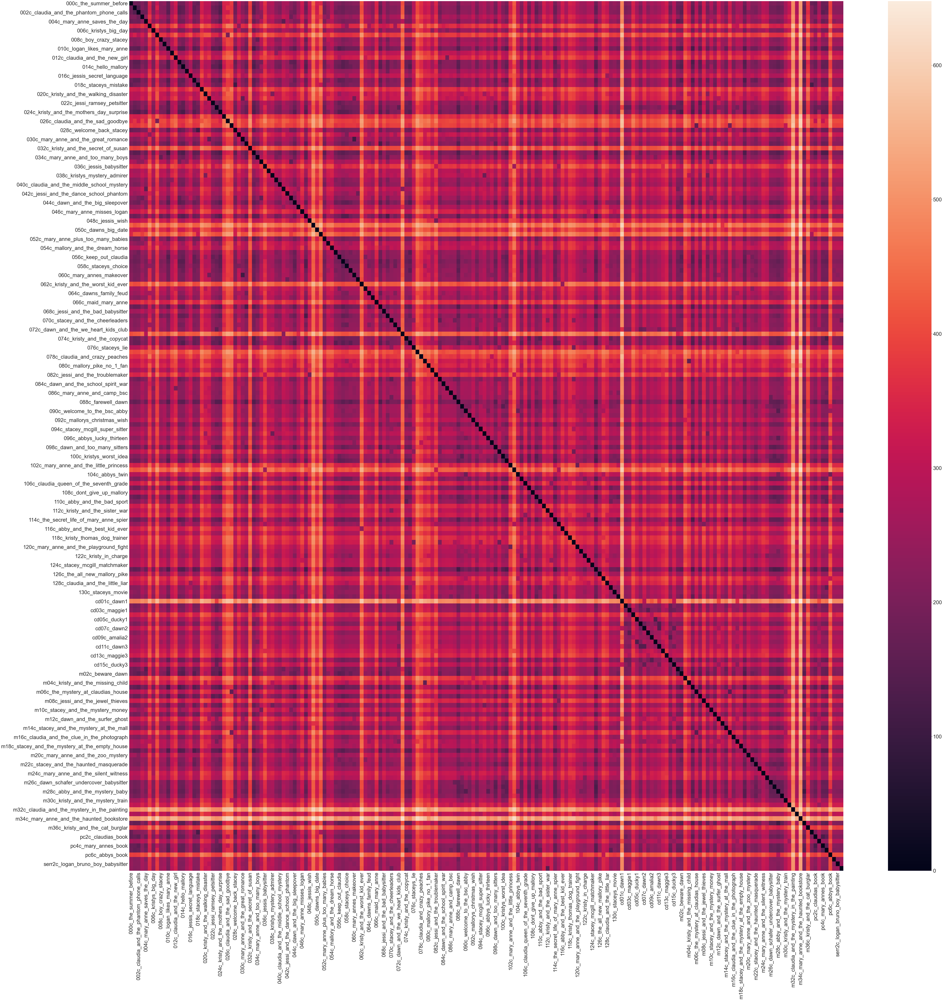

In [7]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(euclidean_distances)
#Displays the image
plt.show()

The output of the heatmap visualization I used to get a sense of the results is a little dazzling. It looks more like one of Mary Anne’s plaid dresses than something you could make sense out of. Each book (in numerical order) is along the vertical and horizontal axes, so you have a black line running diagonally showing that every book is identical to itself. 

If you zoom in enough to read the labels (you can save the images from this Jupyter notebook by ctrl+clicking on them, or you can find them in the GitHub repo), you can start to pick out patterns. *California Diaries: Dawn 1* is one of the bright light-colored lines, meaning it’s very different from the other books. That’s not too surprising, though it’s more surprising that it also looks different from the other *California Diaries* books. *Abby’s Book* from the Portrait Collection (that character’s “autobiography”) is very different from the other Portrait Collection books. There are also a few clusters of noticeably different books scattered throughout the corpus: Mystery #32: *Claudia and the Mystery in the Painting* and Mystery #34: *Mary Anne and the Haunted Bookstore* were about as distinct as California Diaries #1. BSC #103: *Happy Holidays, Jessi*, BSC #73: *Mary Anne and Miss Priss*, and BSC #62: *Kristy and the Worst Kid Ever* also jump out as visibly distinct. There’s also a band of higher general similarity ranging from books #83-101.

It was one of those classic DH moments where I now had a bunch of data, and no idea where to start on interpreting it. 🤯

But then I started to wonder about how good my data even was. Like I mentioned earlier, Euclidean distance is very sensitive to the length of the texts I was comparing. Was it a fair assumption that the books would all be the same length? DH methods make it easy to put our assumptions to the test.

### Counting words
To see if Euclidean distance is a good metric, we need to find out how much variation there is in the text length. For Euclidean distance to work well, we need the input text to be close to the same length.

The first way we'll count is based on BSC sub-sesries. The code below depends on some DSC-specific file-naming conventions, where each file is named with an abbeviation representing the series, followed by the book number.

#### Counting words in full books
We've already specified above that *filedir* is where all our full-text files are, and we should already be in that directory in order to run Euclidean distance. So we can just run this code on the files in our current directory, which should be the full-text files.

In [8]:
#Creates a CSV file for writing the word counts
with open('bsc_series_wordcount.csv', 'w', encoding='utf8') as out:
    #Writes the header row
    out.write('filename, wordcount, series')
    #New line
    out.write('\n')
    #For each file in the directory
    for filename in os.listdir(filedir):
        #If it ends in .txt
        if filename.endswith('.txt'):
            #Open that file
            file = open(filename, "rt", encoding="utf8")
            #Read the file
            data = file.read()
            #Split words based on white space
            words = data.split()
            #If filename starts with 'ss' for Super Special
            if filename.startswith('ss'):
                #Assign 'ss' as the series
                series = 'ss'
            #If filename starts with 'm' for Mystery
            elif filename.startswith('m'):
                #Assign 'm' as the series
                series = 'm'
            #If filename starts with 'cd' for California Diaries
            elif filename.startswith('cd'):
                #Assign 'cd' as the series
                series = 'cd'
            #If the filename starts with 'pc' for Portrait Collection
            elif filename.startswith('pc'):
                #Assign 'pc' as the series
                series = 'pc'
            #If the filename starts with 'ff' for Friends Forever
            elif filename.startswith('ff'):
                #Assign 'ff' as the series
                series = 'ff'
            #Otherwise...
            else:
                #It's a main series book
                series = 'main'
            #Print the filename, comma, length, comma, and series (so we can see it)
            print(filename + ', ' + str(len(words)) + ', ' + series)
            #Write out each of those components to the file
            out.write(filename)
            out.write(', ')
            out.write(str(len(words)))
            out.write(', ')
            out.write(series)
            #Newline so the lines don't all run together
            out.write('\n')

015c_little_miss_stoneybrook_and_dawn.txt, 27087, main
009c_the_ghost_at_dawns_house.txt, 26291, main
pc5c_kristys_book.txt, 21916, pc
016c_jessis_secret_language.txt, 26792, main
091c_claudia_and_the_first_thanksgiving.txt, 23657, main
104c_abbys_twin.txt, 23464, main
037c_dawn_and_the_older_boy.txt, 24120, main
m29c_stacey_and_the_fashion_victim.txt, 27546, m
010c_logan_likes_mary_anne.txt, 25677, main
047c_mallory_on_strike.txt, 29116, main
072c_dawn_and_the_we_heart_kids_club.txt, 23850, main
078c_claudia_and_crazy_peaches.txt, 26259, main
130c_staceys_movie.txt, 22900, main
cd05c_ducky1.txt, 21072, cd
057c_dawn_saves_the_planet.txt, 27411, main
099c_staceys_broken_heart.txt, 28644, main
m01c_stacey_and_the_mystery_ring.txt, 27488, m
cd06c_sunny2.txt, 18404, cd
115c_jessis_big_break.txt, 24112, main
002c_claudia_and_the_phantom_phone_calls.txt, 27930, main
123c_claudias_big_party.txt, 26794, main
m15c_kristy_and_the_vampires.txt, 28095, m
063c_claudias_freind_friend.txt, 26982, mai

#### Counting words by chapter
Now, enter the full path to the directory with your individual-chapter files.

In [9]:
chapterdir = '/Users/qad/Documents/dsc_chapters/allchapters'
#Change to the directory with the individual-chapter files.
os.chdir(chapterdir)

In [10]:
#Creates a CSV file for writing the word counts
with open('bsc_chapter_wordcount.csv', 'w', encoding='utf8') as out:
    #Write header
    out.write('filename, wordcount, chapter_number')
    #Newline
    out.write('\n')
    #For each file in the directory
    for filename in os.listdir(chapterdir):
        #If it ends with .txt
        if filename.endswith('.txt'):
            #Open the file
            file = open(filename, "rt", encoding='utf8')
            #Read the file
            data = file.read()
            #Split words at blank spaces
            words = data.split()
            #If the filename ends with an underscore and number
            #The number goes in the "series" column (it's actually a chapter number)
            if filename.endswith('_1.txt'):
                series = '1'
            elif filename.endswith('_2.txt'):
                series = '2'
            elif filename.endswith('_3.txt'):
                series = '3'
            elif filename.endswith('_4.txt'):
                series = '4'
            elif filename.endswith('_5.txt'):
                series = '5'
            elif filename.endswith('_6.txt'):
                series = '6'
            if filename.endswith('_7.txt'):
                series = '7'
            elif filename.endswith('_8.txt'):
                series = '8'
            elif filename.endswith('_9.txt'):
                series = '9'
            elif filename.endswith('_10.txt'):
                series = '10'
            elif filename.endswith('_11.txt'):
                series = '11'
            elif filename.endswith('_12.txt'):
                series = '12'
            elif filename.endswith('_13.txt'):
                series = '13'
            elif filename.endswith('_14.txt'):
                series = '14'
            elif filename.endswith('_15.txt'):
                series = '15'
            #Print results so we can watch as it goes
            print(filename + ', ' + str(len(words)) + ', ' + series)
            #Write everything out to the CSV file
            out.write(filename)
            out.write(', ')
            out.write(str(len(words)))
            out.write(', ')
            out.write(series)
            out.write('\n')

012c_claudia_and_the_new_girl_1.txt, 1968, 1
m07c_dawn_and_the_disappearing_dogs_11.txt, 1509, 11
112c_kristy_and_the_sister_war_4.txt, 1938, 4
131c_the_fire_at_mary_annes_house_4.txt, 1344, 4
m04c_kristy_and_the_missing_child_11.txt, 1768, 11
058c_staceys_choice_12.txt, 1562, 12
007c_claudia_and_mean_jeanine_6.txt, 2262, 6
031c_dawns_wicked_stepsister_14.txt, 1921, 14
004c_mary_anne_saves_the_day_6.txt, 2137, 6
001c_kristys_great_idea_3.txt, 1893, 3
099c_staceys_broken_heart_1.txt, 2444, 1
005c_dawn_and_the_impossible_three_3.txt, 1940, 3
serr3c_shannons_story_3.txt, 3974, 3
m13c_mary_anne_and_the_library_mystery_1.txt, 2007, 1
047c_mallory_on_strike_13.txt, 2171, 13
083c_stacey_vs_the_bsc_3.txt, 1323, 3
060c_mary_annes_makeover_6.txt, 1750, 6
m33c_stacey_and_the_stolen_hearts_14.txt, 1531, 14
051c_staceys_ex_best_friend_9.txt, 1381, 9
m26c_dawn_schafer_undercover_babysitter_15.txt, 1721, 15
m34c_mary_anne_and_the_haunted_bookstore_8.txt, 2198, 8
095c_kristy_plus_bart_equals_questionm

I put the output files into Tableau (Gantt visualization, configuring length as a dimension under “rows”) after running the code on the full text of all the series, and the chapter length of the main and mystery series (remember, each of those books has 15 chapters).

The books range from around 12,600 words (California Diaries: *Amalia 3*, which is shorter than this DSC book!), to nearly 45,000 words (Super Mystery #1: *Baby-Sitters’ Haunted House*). On the chapter level, there’s not a ton of variation in word length between chapters, though chapter 15 tends to be a bit shorter, and chapter 2 tends to be longer -- there’s a lot of tropes to pack in!

![Gantt chart of book and chapter lengths](images/dsc8_length_measurements.png)

But if we’re using Euclidean distance to compare even chapter 2s, BSC #75: *Jessi’s Horrible Prank* is 1,266 words and BSC #99: *Stacey’s Broken Heart* is 4,293 words. That alone is going to lead to a big difference in the word-count values.

When I first started playing with these text-comparison metrics (before taking the care to properly clean the data and ensure there weren’t problems with my chapter-separating code), I first tried Euclidean distance, and was fascinated by the apparent similarity of chapter 2 in the first Baby-Sitters Club book and a chapter in a California Diaries book. “What,” I wondered, “does wholesome *Kristy’s Great Idea* have to do with salacious *California Diaries?*” 

I laughed out loud when I opened the text files containing the text of those chapters, and immediately saw the answer: what they had in common was data cleaning problems that led to their truncation after a sentence or two. As a Choose Your Own Adventure book might put it, *“You realize that your ‘findings’ are nothing more than your own mistakes in preparing your data set. You sigh wearily. The end.”* Hopefully you, like childhood me, left a bookmark that last decision point you were unsure of, and you can go back and make a different choice. But even if you have to start over from the beginning, you can almost try again when doing DH.


## Cosine similarity
Cosine similarity offers a workaround for the text-scale problems we encountered with Euclidean distance. Instead of trying to measure the **distance** between two points (which can be thrown off due to issues of magnitude, when one point represents a text that’s much longer than the other), it measures the cosine of the angle between them and calls it *similarity*. You may have also filed “cosine” away under “high school math I hoped to never see again”, but don’t panic! As trigonometry starts to flood back at you, you might find yourself wondering, “Why cosine similarity, and not any of its little friends, like sine or tangent?” After all, wouldn’t it be fun to burst into the chorus of Ace of Base’s “I Saw the Sine” whenever you worked out the text similarity?

Mostly it works out to a matter of numerical convenience in setting up the framing for measuring similarity: If the angle between two points is 0, then that means any difference is just one of *magnitude* (which we don’t worry about with cosine similarity) and you can say the texts are extremely similar. If the angle is 90 degrees, which is as far as you can get while staying in all-positive numbers (we don’t have any negative word counts), then there’s a huge difference. Cos(0) = 1, and cos(90) = 0, so with cosine similarity, you want **larger** numbers for more similarity. Which is the opposite of Euclidean distance, where you want **smaller** numbers for more similarity (because using that measure, 0 means “there’s no distance between these things and they are the same”). I’ve screwed this up more than once, getting excited about large numbers when using an algorithm where you want smaller numbers, and vice versa. Always double-check the scale you’re using and what counts as “similar” if you’re not sure. Or, as you might find in a Choose Your Own Adventure book: *“The tweet was written, delayed only by the search for the perfect celebratory emoji to decorate its conclusion, when a small voice echoes in the back of your head. ‘Should these be large numbers? What algorithm did you use?’ You pause and think for a moment… then sigh, delete the tweet, and return to your code to start over. The end.”*

But before you start writing “**EUCLIDEAN = SMALL, COSINE = BIG**” in sharpie on a sticky note and putting it on your wall with extra tape for reinforcement, the people who write Python packages realized it’s going to be a problem if they write a package where you can easily swap in different metrics, but some of them use large numbers for similarity, while others use small numbers. So what you’ll see in the Jupyter notebook is that it’s calculating cosine *distance* -- which is just (1 - cosine similarity). After that bit of subtraction, “exactly the same” has a value of 0, just like you’d get in Euclidean distance. 

We’re still not exactly comparing apples to apples here: you’re going to get much bigger numbers when calculating Euclidean distance than when calculating cosine distance, which makes sense. Euclidean distance is a kind of actual distance. Cosine distance is still just an angle between two vectors, which looks like a percentage, with a bit of manipulation to make “identical” work out to 0. The numbers are a lot smaller, and their range is a lot more compressed (from 0 to .99 for cosine distance, vs. 0 to 650 in our data set for Euclidean distance). The Euclidean distance score can be more nuanced, but this is a situation where nuance is a bad thing. I’m not doing this particular analysis to find precisely how different the texts are from each other -- which is a good thing, because I know the variable length is a distorting factor that would prevent me from getting to that perfect number anyway. What I’m looking for is book pairings that stand out as noteworthy, either for their similarity or dissimilarity. And the compressed range of possible values for cosine distance makes those differences more visible. 

Running the Euclidean distance calculation didn't do anything to the results of our count vectorizer, so if you're working through this book in order, you should be able to just run the cosine distance calculation below. If you have trouble, you can rerun the code cell with the CountVectorizer code in it -- just make sure you've got it pointing to the right directory with the full text files.

In [11]:
cosine_distances = pd.DataFrame(squareform(pdist(wordcounts, metric='cosine')), index=filekeys, columns=filekeys)
cosine_distances

,000c_the_summer_before,001c_kristys_great_idea,002c_claudia_and_the_phantom_phone_calls,003c_the_truth_about_stacey,004c_mary_anne_saves_the_day,005c_dawn_and_the_impossible_three,006c_kristys_big_day,007c_claudia_and_mean_jeanine,008c_boy_crazy_stacey,009c_the_ghost_at_dawns_house,...,m36c_kristy_and_the_cat_burglar,pc1c_staceys_book,pc2c_claudias_book,pc3c_dawns_book,pc4c_mary_annes_book,pc5c_kristys_book,pc6c_abbys_book,serr1c_logans_story,serr2c_logan_bruno_boy_babysitter,serr3c_shannons_story
000c_the_summer_before,0.000000,0.713682,0.619032,0.582249,0.573231,0.896098,0.832126,0.572193,0.755619,0.764822,...,0.939076,0.507250,0.556577,0.913384,0.671589,0.758748,0.920182,0.880565,0.913763,0.885829
001c_kristys_great_idea,0.713682,0.000000,0.492413,0.681616,0.783353,0.911498,0.859378,0.789081,0.888678,0.731887,...,0.967335,0.939854,0.872472,0.943598,0.904584,0.898065,0.980270,0.932188,0.952004,0.918028
002c_claudia_and_the_phantom_phone_calls,0.619032,0.492413,0.000000,0.438189,0.664592,0.928928,0.848969,0.470468,0.908284,0.777697,...,0.808612,0.924519,0.645428,0.949983,0.641644,0.874637,0.980874,0.932040,0.896295,0.910428
003c_the_truth_about_stacey,0.582249,0.681616,0.438189,0.000000,0.731113,0.964981,0.866939,0.663324,0.942381,0.792115,...,0.831450,0.706039,0.797737,0.952098,0.835715,0.936946,0.984321,0.935222,0.896311,0.887956
004c_mary_anne_saves_the_day,0.573231,0.783353,0.664592,0.731113,0.000000,0.892197,0.880304,0.431425,0.811704,0.816308,...,0.962725,0.944486,0.721621,0.948991,0.709130,0.899979,0.977696,0.773900,0.919541,0.934259
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pc5c_kristys_book,0.758748,0.898065,0.874637,0.936946,0.899979,0.927234,0.882085,0.836247,0.923280,0.951684,...,0.961104,0.928659,0.805224,0.893659,0.823510,0.000000,0.958598,0.886807,0.936619,0.889512
pc6c_abbys_book,0.920182,0.980270,0.980874,0.984321,0.977696,0.986311,0.979436,0.989931,0.967925,0.986640,...,0.937815,0.962131,0.940998,0.973152,0.938346,0.958598,0.000000,0.984834,0.984298,0.974587
serr1c_logans_story,0.880565,0.932188,0.932040,0.935222,0.773900,0.957424,0.949962,0.923127,0.877722,0.915415,...,0.966749,0.957765,0.929770,0.951530,0.951290,0.886807,0.984834,0.000000,0.752683,0.948513
serr2c_logan_bruno_boy_babysitter,0.913763,0.952004,0.896295,0.896311,0.919541,0.934367,0.961223,0.972836,0.876257,0.888373,...,0.907251,0.957883,0.941948,0.969854,0.910845,0.936619,0.984298,0.752683,0.000000,0.945843


In [12]:
cosine_distances.to_csv('cosine_distances_count.csv')

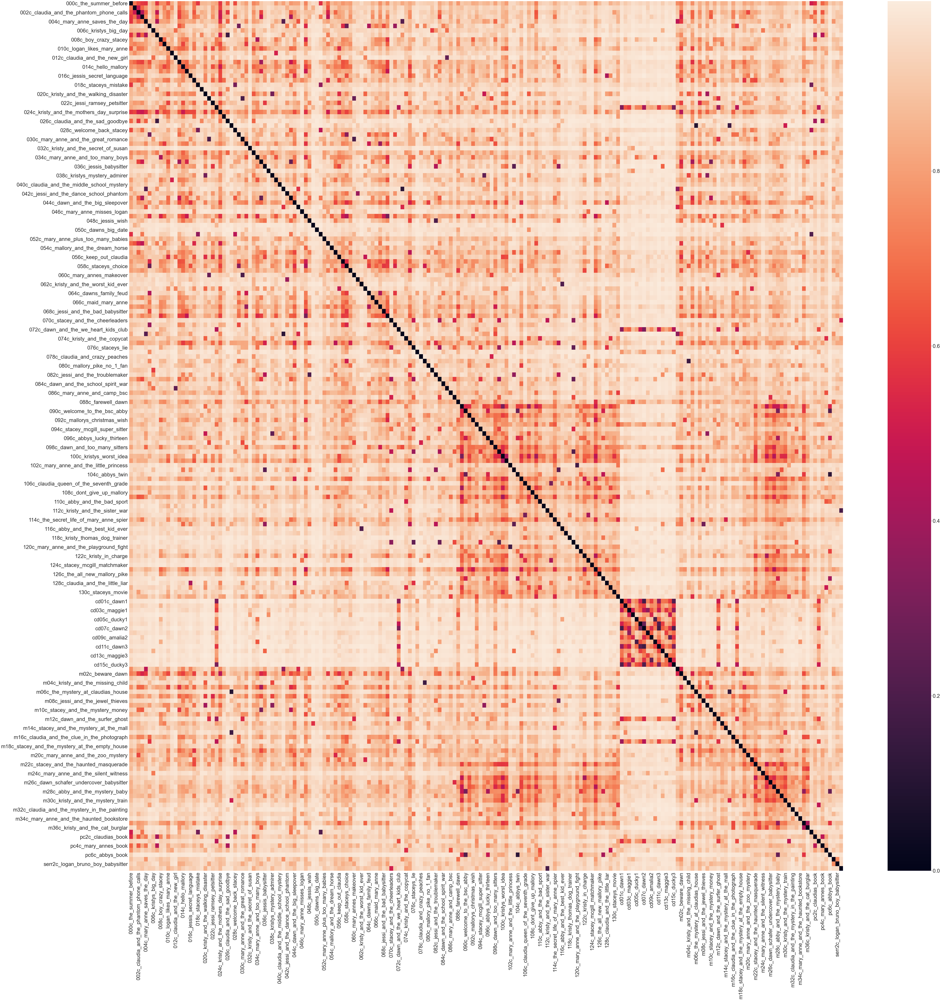

In [13]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(cosine_distances)
#Displays the image
plt.show()

A sort of light salmon in the Euclidean distance visualization represented a value of 500, and the same color represents .8 in the cosine distance visualization. To my mind, the overall impression is less of Mary Anne’s classic plaid, and more like a dirty Kristy’s Krushers baseball jersey with flecks and blobs of spaghetti sauce here and there. (I’ll note that there’s some disagreement here within the DSC; Katia’s reaction was “Plaid in salmon and pink? Sickening, but still something Mary Anne’s dad would make her wear.”)

It’s not pretty, but it’s clarifying.

First, those super-light bands that are quite similar to one another (where they intersect in a box around the black diagonal line), but quite dissimilar from everything else? That’s the California Diaries series. And California Diaries: *Dawn 1* is still a little lighter than all the rest of that sub-series, but not so much so. This visualization makes it easier to see that the California Diaries are much more similar to regular-series books set in California, like BSC #23: *Dawn on the Coast* and BSC #72: *Dawn and the We <3 Kids Club*. It’s not a groundbreaking discovery, but it immediately makes sense! And honestly, “boring” DH results are often a sign that you’ve done something right.

*Abby’s Book* is still fairly distinct, but this visualization makes it easier to see some of the points of overlap for the other Portrait Collection books, like the overlap between Claudia’s and Mary Anne’s autobiographies and BSC #7: *Claudia and Mean Janine*, which features Kishi family drama and a focus on Claudia’s grandmother Mimi, who was an important figure in both girls’ lives. There are also speckles of dark spots on the visualization, which mostly seem to correspond to books with the same narrator. It’s particularly prominent with distinctive narrators, like Jessi, whose interests and perspective are not shared by the other characters.

The phenomenon involving books #83-101 forming a cluster (including, we can see here, the mystery novels published around the same time period) is still visible here. I don’t have an explanation (though Anouk suspects possible editorial influence since the books are sequential), but this could be something worth exploring later.

But while this has been an interesting diversion, let’s get back to chapter 2! After running just the chapter 2s through the same cosine distance calculation, here’s what we get.

In [14]:
ch2dir = '/Users/qad/Documents/dsc_chapters/ch2'
os.chdir(ch2dir)

In [15]:
# Use the glob library to create a list of file names, sorted alphabetically
# Alphabetical sorting will get us the books in numerical order
filenames = sorted(glob.glob("*.txt"))
# Parse those filenames to create a list of file keys (ID numbers)
# You'll use these later on.
filekeys = [f.split('/')[-1].split('.')[0] for f in filenames]

# Create a CountVectorizer instance with the parameters you need
vectorizer = CountVectorizer(input="filename", max_features=1000, max_df=0.7)
# Run the vectorizer on your list of filenames to create your wordcounts
# Use the toarray() function so that SciPy will accept the results
ch2 = vectorizer.fit_transform(filenames).toarray()

In [16]:
ch2_cosine = pd.DataFrame(squareform(pdist(ch2, metric='cosine')), index=filekeys, columns=filekeys)
ch2_cosine

,001c_kristys_great_idea_2,002c_claudia_and_the_phantom_phone_calls_2,003c_the_truth_about_stacey_2,004c_mary_anne_saves_the_day_2,005c_dawn_and_the_impossible_three_2,006c_kristys_big_day_2,007c_claudia_and_mean_jeanine_2,008c_boy_crazy_stacey_2,009c_the_ghost_at_dawns_house_2,010c_logan_likes_mary_anne_2,...,m30c_kristy_and_the_mystery_train_2,m31c_mary_anne_and_the_music_box_secret_2,m32c_claudia_and_the_mystery_in_the_painting_2,m33c_stacey_and_the_stolen_hearts_2,m34c_mary_anne_and_the_haunted_bookstore_2,m35c_abby_and_the_notorius_neighbor_2,m36c_kristy_and_the_cat_burglar_2,serr1c_logans_story_2,serr2c_logan_bruno_boy_babysitter_2,serr3c_shannons_story_2
001c_kristys_great_idea_2,0.000000,0.766090,0.645483,0.531795,0.675465,0.656225,0.688112,0.764615,0.766119,0.761255,...,0.786214,0.802706,0.737756,0.731130,0.723651,0.715903,0.886659,0.791623,0.780976,0.797041
002c_claudia_and_the_phantom_phone_calls_2,0.766090,0.000000,0.666760,0.739101,0.765984,0.691542,0.731188,0.737672,0.750627,0.664367,...,0.798273,0.844518,0.790636,0.804286,0.799606,0.762009,0.889835,0.705636,0.738903,0.795357
003c_the_truth_about_stacey_2,0.645483,0.666760,0.000000,0.661717,0.707359,0.665165,0.663676,0.710884,0.760346,0.748608,...,0.764393,0.807352,0.749600,0.758404,0.712565,0.653595,0.895618,0.692688,0.718258,0.814498
004c_mary_anne_saves_the_day_2,0.531795,0.739101,0.661717,0.000000,0.639950,0.625909,0.702424,0.740980,0.720565,0.753377,...,0.760781,0.806796,0.758356,0.748060,0.756648,0.738210,0.903046,0.764599,0.748895,0.836030
005c_dawn_and_the_impossible_three_2,0.675465,0.765984,0.707359,0.639950,0.000000,0.721849,0.613405,0.763808,0.852449,0.786941,...,0.769214,0.773123,0.740475,0.686315,0.706921,0.691431,0.911044,0.697064,0.668238,0.854810
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
m35c_abby_and_the_notorius_neighbor_2,0.715903,0.762009,0.653595,0.738210,0.691431,0.758548,0.731529,0.773304,0.762364,0.804598,...,0.590592,0.555394,0.604087,0.547327,0.537541,0.000000,0.820411,0.645871,0.607143,0.804980
m36c_kristy_and_the_cat_burglar_2,0.886659,0.889835,0.895618,0.903046,0.911044,0.891551,0.914885,0.911541,0.911166,0.915891,...,0.911671,0.921123,0.901557,0.903830,0.866497,0.820411,0.000000,0.913101,0.898953,0.925601
serr1c_logans_story_2,0.791623,0.705636,0.692688,0.764599,0.697064,0.768548,0.778784,0.819493,0.793814,0.818823,...,0.712838,0.695023,0.723235,0.648015,0.692043,0.645871,0.913101,0.000000,0.543022,0.821760
serr2c_logan_bruno_boy_babysitter_2,0.780976,0.738903,0.718258,0.748895,0.668238,0.740903,0.745459,0.808759,0.832129,0.782887,...,0.683610,0.655754,0.645678,0.609764,0.631424,0.607143,0.898953,0.543022,0.000000,0.842790


In [17]:
ch2_cosine.to_csv('ch2_cosine_count.csv')

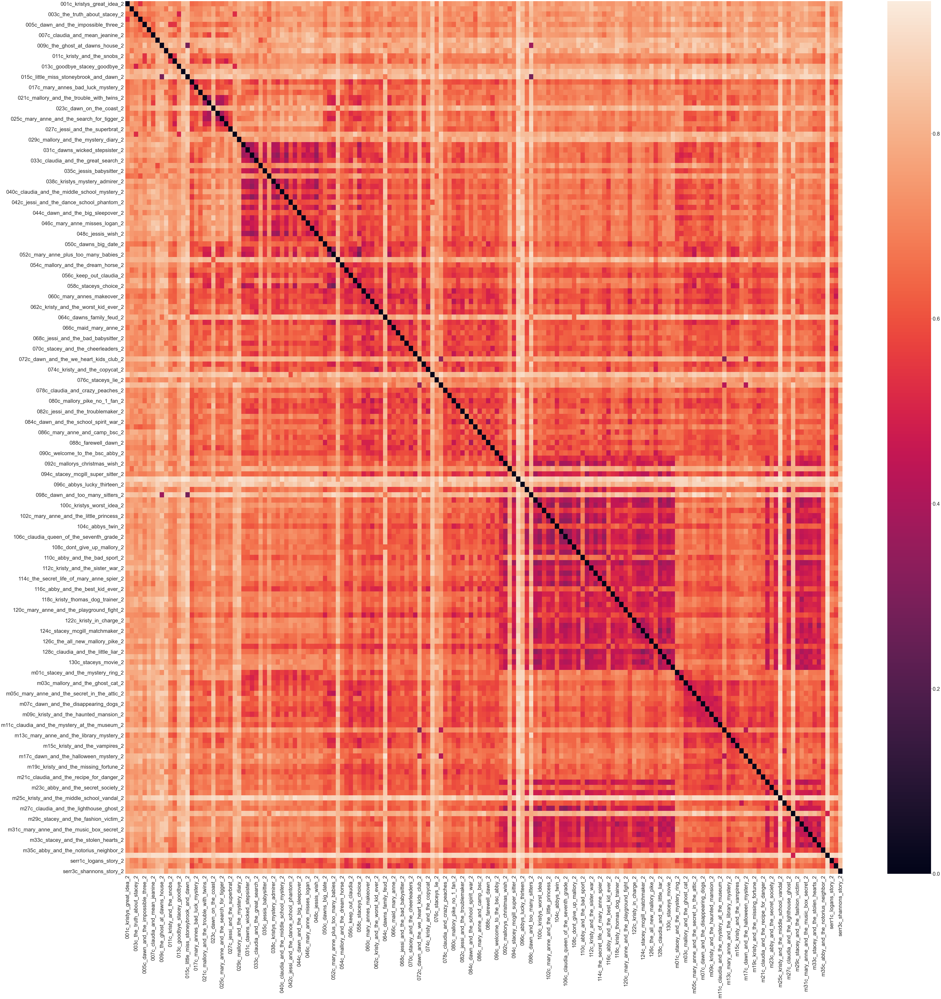

In [18]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(ch2_cosine)
#Displays the image
plt.show()

I did a double-take when I saw it, and went back to check the code and make sure I hadn’t accidentally run Euclidean distance again. The chapter 2s are *a lot* closer than the books overall. Which makes sense -- the reason we’re looking at chapter 2 is because we know it’s repetitive. This is a smaller data set than what we used for the full book comparison, including only chapter 2s from the main and mystery series (which follow the 15-chapter structure). Even the chapter 2s show the pattern of similarity for books #83-101 and temporally-similar mysteries, and there’s another cluster from books #30-48. The light-colored lines reflect another known phenomenon about chapter 2, where sometimes the typical “chapter 2” content actually appears in chapter 3.

To drive home the point that there’s something different going on here with chapter 2, I re-ran cosine distance on four other chapters: 1, 5 (top row), 9, and 15.

(I'm not going to repeat the code for calculating these here; it's the same as the chapter 2 code above, with different source folders.)

![Cosine distance for chapters 1, 5, 9, and 15](images/dsc8_ch_1_5_9_15.png)

There are some interesting things that we could dig into here! It looks like there’s more overlap in how the books end (ch. 15, bottom right) than how the middle of the book goes, though there are lots of individual speckles of high similarity for the middle chapters. Chapter 1 starts similarly in the early books, but is pretty dispersed by the end. The cluster in books #83-101 isn’t really visible in these chapters. But the crucial thing we’re seeing is just that chapter 2s are **much more similar** to one another than other chapters.

## Word counts or word frequencies?

I ran this part by Mark, pleased with myself for having worked through a tutorial, modified it to fit what I wanted to work on, and come up with a largely interpretable result that was brimming with possibilities for things to explore next. 

His response caught me completely off-guard: “You scaled, or otherwise normalized, your word counts, right? RIGHT? RIGHT?!?!? I only ask because you don’t mention it anywhere, and if you don’t normalize your word counts by turning them into word frequencies, you are only really going to ever find out about what texts are longer than others.”

Uh-oh. That *Programming Historian* tutorial hadn’t said anything about word **frequencies**. In fact, it’d used the word *count* vectorizer in its code. I knew that would be a problem for Euclidean distance, but I’d hoped that cosine distance would… solve it?

“If you use frequencies instead of counts, then you can compare texts that are of somewhat different lengths (within an order of magnitude) pretty effectively,” suggested Mark. “The big problem with Euclidean distances are 0 values. When you use too many dimensions, especially when you use word frequencies, there are a lot of 0s, and these are overweighted by Euclidean distance so that similar texts of very different lengths look much more different than they should – because the longer text has a lot of words that the shorter text doesn’t have (and the reverse is not as true – the shorter text has far fewer words that the longer text doesn’t have). So, when you compare a novel to a short story (or a LONG novel to a normal novel), this becomes a real problem. Cosine is still probably a better metric for the kind of work that you are doing, but here too it is crucial to scale/normalize your counts – otherwise size just keeps becoming a factor. Normalizing word counts is such a crucial point in the process and you don’t actually mention it, that it has me worried.”

Now I was worried, too. I definitely had **not** normalized the word counts. I guess I could figure out how to create a table with each word and its word count and then generate a frequency by dividing by the sum of all the words, but how would I then feed those frequencies back into the vectorizer pipeline? In the peaceful, dark hours of Insomnia O’Clock, I curled up with the documentation for scikit-learn, the Python library I used for the vectorizer, to see if it offered any better options.

And to my delight, it did! The TF-IDF vectorizer was there to save the day. Now, TF-IDF (term frequency - inverse document frequency, which tries to get at *distinctive words* in each text) wasn’t what I wanted -- not yet. (We’ll get to that soon enough; it’s a very different method for evaluating similarity.) But you can’t spell TF-IDF without TF, and since TF is “term frequency”, it’s exactly the thing I was looking for!

If using term frequency helps accounting for differences in length, I expected that running Euclidean distance on a matrix of word frequencies should look something like the Cosine distance on a matrix of word counts, right? Let’s compare the first version and the normalized version comparing the full books using Euclidean distance!

### Euclidean distance with word frequencies
Because we were in the directory with the chapter 2's, we need to go back to the directory with the full text.

In [19]:
filedir = '/Users/qad/Documents/dsc_corpus_clean'
os.chdir(filedir)

This time we're using the TF-IDF vectorizer, with the "IDF" part turned off:

In [20]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Use the glob library to create a list of file names, sorted alphabetically
# Alphabetical sorting will get us the books in numerical order
filenames = sorted(glob.glob("*.txt"))
# Parse those filenames to create a list of file keys (ID numbers)
# You'll use these later on.
filekeys = [f.split('/')[-1].split('.')[0] for f in filenames]

# Create a CountVectorizer instance with the parameters you need
vectorizer = TfidfVectorizer(input="filename", stop_words=None, use_idf=False, norm=None, max_features=1000)
# Run the vectorizer on your list of filenames to create your wordcounts
# Use the toarray() function so that SciPy will accept the results
wordfreqs = vectorizer.fit_transform(filenames).toarray()

<div class="alert alert-block alert-success">
<b>Note:</b> See what happened here? I had to figure out a method to do something, where there wasn't an out-of-the-box solution I could just pull from a tutorial I was following. As a result, I thought about all the parameters and picked better ones-- and did <em>not</em> throw out words shared by 70% of the corpus.
    
So that was good. But the surprise that followed wasn't enough to make me suspicious about the parameters from the first time I ran the vectorizer.
    
I guess I've managed to be a walking case study in the point Mark was making about the dangers of just reusing things you find online without being very critical about everything that goes into them. But at least I'm a self-aware walking case study... even if it takes until the 11th hour.
</div>

In [21]:
euclidean_distances_freq = pd.DataFrame(squareform(pdist(wordfreqs, metric='euclidean')), index=filekeys, columns=filekeys)
euclidean_distances_freq

,000c_the_summer_before,001c_kristys_great_idea,002c_claudia_and_the_phantom_phone_calls,003c_the_truth_about_stacey,004c_mary_anne_saves_the_day,005c_dawn_and_the_impossible_three,006c_kristys_big_day,007c_claudia_and_mean_jeanine,008c_boy_crazy_stacey,009c_the_ghost_at_dawns_house,...,m36c_kristy_and_the_cat_burglar,pc1c_staceys_book,pc2c_claudias_book,pc3c_dawns_book,pc4c_mary_annes_book,pc5c_kristys_book,pc6c_abbys_book,serr1c_logans_story,serr2c_logan_bruno_boy_babysitter,serr3c_shannons_story
000c_the_summer_before,0.000000,1688.674924,1585.480684,1505.149826,1414.203663,1475.682215,1565.950829,1772.344775,1769.620016,1681.382170,...,1766.014722,1540.024675,1497.271852,1804.691940,1627.442165,1926.672520,2106.107785,1826.547289,1973.011911,1588.887347
001c_kristys_great_idea,1688.674924,0.000000,617.234153,612.441834,655.706489,671.600328,550.912879,590.251641,609.888514,663.587975,...,735.306059,818.899872,720.864758,766.713767,778.387436,710.456191,880.771821,565.996466,655.877275,640.468578
002c_claudia_and_the_phantom_phone_calls,1585.480684,617.234153,0.000000,584.428781,544.864203,578.813441,618.004045,672.802348,633.221920,502.952284,...,703.283016,767.949868,678.567609,729.702679,726.657416,805.578053,1032.753117,606.353032,688.671910,635.008661
003c_the_truth_about_stacey,1505.149826,612.441834,584.428781,0.000000,533.235408,659.113040,657.785679,690.512853,735.329178,734.152573,...,846.965170,737.004749,748.245281,814.447666,789.385837,885.817701,1016.655300,732.601529,836.303773,708.062850
004c_mary_anne_saves_the_day,1414.203663,655.706489,544.864203,533.235408,0.000000,608.815243,661.913892,660.938726,771.198418,718.149010,...,857.289916,717.803594,676.698604,789.976582,693.593541,891.163846,1067.084814,725.124127,849.795269,635.373119
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pc5c_kristys_book,1926.672520,710.456191,805.578053,885.817701,891.163846,956.911177,761.767025,755.255586,651.803651,718.507481,...,739.081186,691.876434,665.522351,477.403393,559.309396,0.000000,599.125196,525.301818,522.293979,646.618899
pc6c_abbys_book,2106.107785,880.771821,1032.753117,1016.655300,1067.084814,1113.974865,928.422318,847.522271,821.579576,921.745084,...,962.580906,891.654642,885.428145,677.029541,841.609173,599.125196,0.000000,745.013423,743.158126,787.810256
serr1c_logans_story,1826.547289,565.996466,606.353032,732.601529,725.124127,765.571029,629.125584,642.606411,475.892845,546.162064,...,678.774631,755.434312,643.962732,587.903053,661.846659,525.301818,745.013423,0.000000,351.378713,573.656692
serr2c_logan_bruno_boy_babysitter,1973.011911,655.877275,688.671910,836.303773,849.795269,878.529453,754.179024,704.905667,580.464469,629.216974,...,695.925283,834.915565,784.807620,641.763975,701.231773,522.293979,743.158126,351.378713,0.000000,695.635681


In [22]:
euclidean_distances_freq.to_csv('euclidean_distances_freq.csv')

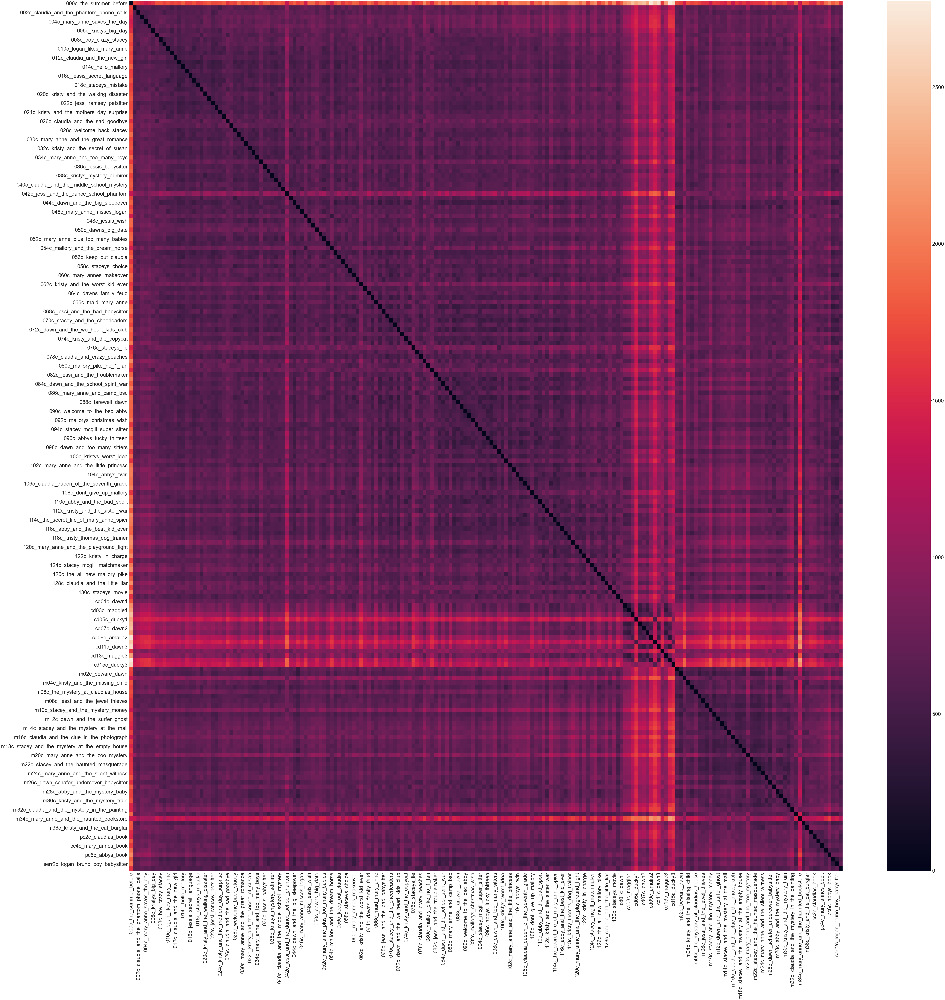

In [23]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(euclidean_distances_freq)
#Displays the image
plt.show()

Oh.

Once you normalize for length, all the Baby-Sitters Club books look… mostly the same. Even with Euclidean distance. So what am I even going to get for Cosine distance using term frequencies?

### Cosine distance with word frequencies
We've already used the TF-IDF vectorizer, so now we just need to do a different distance calculation.

In [24]:
cosine_distances_freq = pd.DataFrame(squareform(pdist(wordfreqs, metric='cosine')), index=filekeys, columns=filekeys)
cosine_distances_freq

,000c_the_summer_before,001c_kristys_great_idea,002c_claudia_and_the_phantom_phone_calls,003c_the_truth_about_stacey,004c_mary_anne_saves_the_day,005c_dawn_and_the_impossible_three,006c_kristys_big_day,007c_claudia_and_mean_jeanine,008c_boy_crazy_stacey,009c_the_ghost_at_dawns_house,...,m36c_kristy_and_the_cat_burglar,pc1c_staceys_book,pc2c_claudias_book,pc3c_dawns_book,pc4c_mary_annes_book,pc5c_kristys_book,pc6c_abbys_book,serr1c_logans_story,serr2c_logan_bruno_boy_babysitter,serr3c_shannons_story
000c_the_summer_before,0.000000,0.044943,0.049422,0.046609,0.035678,0.046631,0.040590,0.056732,0.047167,0.050052,...,0.070188,0.041035,0.021208,0.042741,0.034981,0.034575,0.069217,0.035023,0.049642,0.029316
001c_kristys_great_idea,0.044943,0.000000,0.036930,0.030929,0.033798,0.035493,0.030381,0.039936,0.042907,0.048608,...,0.059447,0.067061,0.055227,0.068699,0.067711,0.052707,0.084284,0.034375,0.042900,0.045442
002c_claudia_and_the_phantom_phone_calls,0.049422,0.036930,0.000000,0.031004,0.025655,0.028958,0.037465,0.043617,0.036552,0.024306,...,0.049127,0.057083,0.045569,0.048338,0.052466,0.049403,0.094011,0.025650,0.028017,0.039682
003c_the_truth_about_stacey,0.046609,0.030929,0.031004,0.000000,0.024914,0.038010,0.039380,0.039519,0.043885,0.048400,...,0.066079,0.049764,0.051218,0.053225,0.056318,0.051572,0.071363,0.034661,0.041751,0.044552
004c_mary_anne_saves_the_day,0.035678,0.033798,0.025655,0.024914,0.000000,0.032055,0.038245,0.032416,0.045906,0.043641,...,0.065060,0.045676,0.039438,0.044694,0.039605,0.046447,0.076709,0.028795,0.038371,0.032554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pc5c_kristys_book,0.034575,0.052707,0.049403,0.051572,0.046447,0.059819,0.045754,0.066528,0.051282,0.049524,...,0.052561,0.027891,0.033378,0.028447,0.024882,0.000000,0.058998,0.039247,0.043466,0.037280
pc6c_abbys_book,0.069217,0.084284,0.094011,0.071363,0.076709,0.088233,0.073567,0.082781,0.083394,0.088067,...,0.097452,0.058017,0.069955,0.059107,0.071658,0.058998,0.000000,0.080784,0.091230,0.057229
serr1c_logans_story,0.035023,0.034375,0.025650,0.034661,0.028795,0.034767,0.032406,0.049176,0.027702,0.028677,...,0.048107,0.049055,0.038349,0.046504,0.047611,0.039247,0.080784,0.000000,0.016501,0.032945
serr2c_logan_bruno_boy_babysitter,0.049642,0.042900,0.028017,0.041751,0.038371,0.043324,0.044590,0.056601,0.039091,0.033917,...,0.044664,0.055314,0.055859,0.055186,0.048879,0.043466,0.091230,0.016501,0.000000,0.046193


In [25]:
cosine_distances_freq.to_csv('cosine_distances_freq.csv')

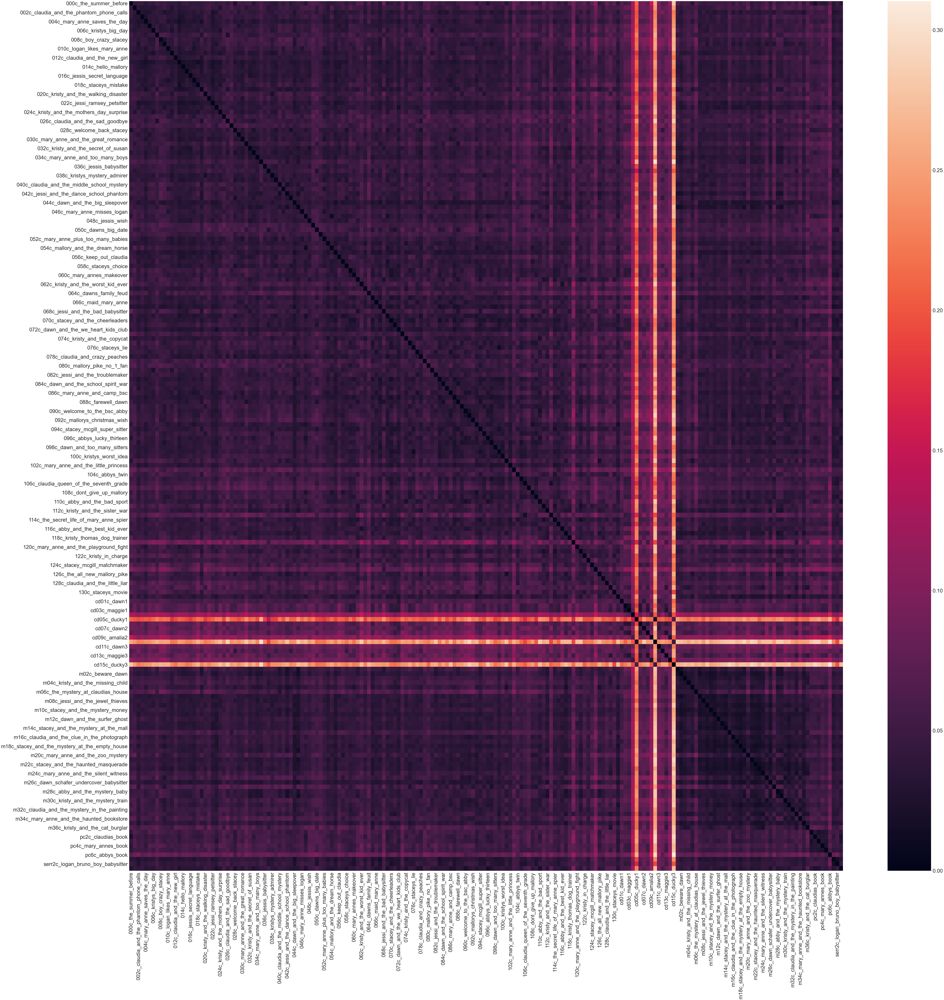

In [26]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(cosine_distances_freq)
#Displays the image
plt.show()

We’ve gone from Mary Anne Plaid to a sort of Claudia Eggplant. Could that be right? Is most of the difference really attributable to length? Even the clear-as-day California Diaries cluster has mostly washed out, except for those shining lights of difference: Ducky, and to a lesser extent, Amalia. (I guess after normalizing for length, what really makes a difference in this corpus is East Coast people vs. West Coast people… and Dawn has assimilated to Connecticut more than she realizes.)

This is something that we can check pretty easily! We already wrote up some code to do word counts for all the books. Are the books that stood out before, and have now disappeared into the purple morass, particularly long or short? That does turn out to be the answer with the California Diaries cluster: all of them are shorter than your average BSC book. And it’s also the answer with Abby’s Portrait Collection looking different than the other Portrait Collection books, coming in at only 78% of the length of Stacey's Portrait Collection book.

<div class="alert alert-block alert-info">
    <b>Note:</b> Remember, I didn't realize it at the time, but there were <strong>two</strong> things that this variant was accounting for: text length, and also <em>not throwing out words that 70% of the books have in common, which includes important things in this corpus like character names!</em></div>

So what happens when we look at cosine distance for chapter 2’s, comparing the count- and frequency-variants?

In [27]:
ch2dir = '/Users/qad/Documents/dsc_chapters/ch2'
os.chdir(ch2dir)

In [28]:
# Use the glob library to create a list of file names, sorted alphabetically
# Alphabetical sorting will get us the books in numerical order
filenames = sorted(glob.glob("*.txt"))
# Parse those filenames to create a list of file keys (ID numbers)
# You'll use these later on.
filekeys = [f.split('/')[-1].split('.')[0] for f in filenames]

# Create a CountVectorizer instance with the parameters you need
vectorizer = TfidfVectorizer(input="filename", stop_words=None, use_idf=False, norm=None, max_features=1000)
# Run the vectorizer on your list of filenames to create your wordcounts
# Use the toarray() function so that SciPy will accept the results
ch2freqs = vectorizer.fit_transform(filenames).toarray()

In [29]:
ch2_cosine_freq = pd.DataFrame(squareform(pdist(ch2freqs, metric='cosine')), index=filekeys, columns=filekeys)
ch2_cosine_freq

,001c_kristys_great_idea_2,002c_claudia_and_the_phantom_phone_calls_2,003c_the_truth_about_stacey_2,004c_mary_anne_saves_the_day_2,005c_dawn_and_the_impossible_three_2,006c_kristys_big_day_2,007c_claudia_and_mean_jeanine_2,008c_boy_crazy_stacey_2,009c_the_ghost_at_dawns_house_2,010c_logan_likes_mary_anne_2,...,m30c_kristy_and_the_mystery_train_2,m31c_mary_anne_and_the_music_box_secret_2,m32c_claudia_and_the_mystery_in_the_painting_2,m33c_stacey_and_the_stolen_hearts_2,m34c_mary_anne_and_the_haunted_bookstore_2,m35c_abby_and_the_notorius_neighbor_2,m36c_kristy_and_the_cat_burglar_2,serr1c_logans_story_2,serr2c_logan_bruno_boy_babysitter_2,serr3c_shannons_story_2
001c_kristys_great_idea_2,0.000000,0.206412,0.113674,0.150443,0.125802,0.115092,0.178066,0.125936,0.190399,0.198563,...,0.164629,0.197586,0.143086,0.180067,0.163321,0.125262,0.268084,0.156328,0.185042,0.189323
002c_claudia_and_the_phantom_phone_calls_2,0.206412,0.000000,0.163208,0.160833,0.114802,0.183622,0.139114,0.192687,0.173620,0.183036,...,0.156327,0.185861,0.126021,0.147126,0.148118,0.128377,0.231286,0.142476,0.126149,0.187776
003c_the_truth_about_stacey_2,0.113674,0.163208,0.000000,0.114385,0.121479,0.112804,0.147225,0.132875,0.125324,0.127333,...,0.147476,0.167143,0.114144,0.135722,0.126646,0.092395,0.242669,0.119585,0.146606,0.138360
004c_mary_anne_saves_the_day_2,0.150443,0.160833,0.114385,0.000000,0.155826,0.149403,0.182614,0.167282,0.134859,0.120849,...,0.198136,0.212283,0.163036,0.188255,0.181516,0.154926,0.225048,0.163295,0.201479,0.161856
005c_dawn_and_the_impossible_three_2,0.125802,0.114802,0.121479,0.155826,0.000000,0.150850,0.126401,0.131118,0.193453,0.204176,...,0.102185,0.143733,0.091190,0.107729,0.119510,0.085736,0.265262,0.107738,0.115631,0.176527
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
m35c_abby_and_the_notorius_neighbor_2,0.125262,0.128377,0.092395,0.154926,0.085736,0.138655,0.133336,0.147063,0.147175,0.161961,...,0.082940,0.081991,0.058391,0.065696,0.057936,0.000000,0.268627,0.072937,0.067835,0.145117
m36c_kristy_and_the_cat_burglar_2,0.268084,0.231286,0.242669,0.225048,0.265262,0.218984,0.281148,0.268710,0.251897,0.240916,...,0.327963,0.336943,0.295650,0.312225,0.284412,0.268627,0.000000,0.286544,0.303065,0.267370
serr1c_logans_story_2,0.156328,0.142476,0.119585,0.163295,0.107738,0.182890,0.193107,0.166469,0.180923,0.192775,...,0.087625,0.108703,0.072981,0.086351,0.116175,0.072937,0.286544,0.000000,0.072080,0.159806
serr2c_logan_bruno_boy_babysitter_2,0.185042,0.126149,0.146606,0.201479,0.115631,0.177894,0.179056,0.187980,0.172765,0.208924,...,0.081543,0.079132,0.062328,0.081043,0.072673,0.067835,0.303065,0.072080,0.000000,0.158507


In [30]:
ch2_cosine_freq.to_csv('ch2_cosine_freq.csv')

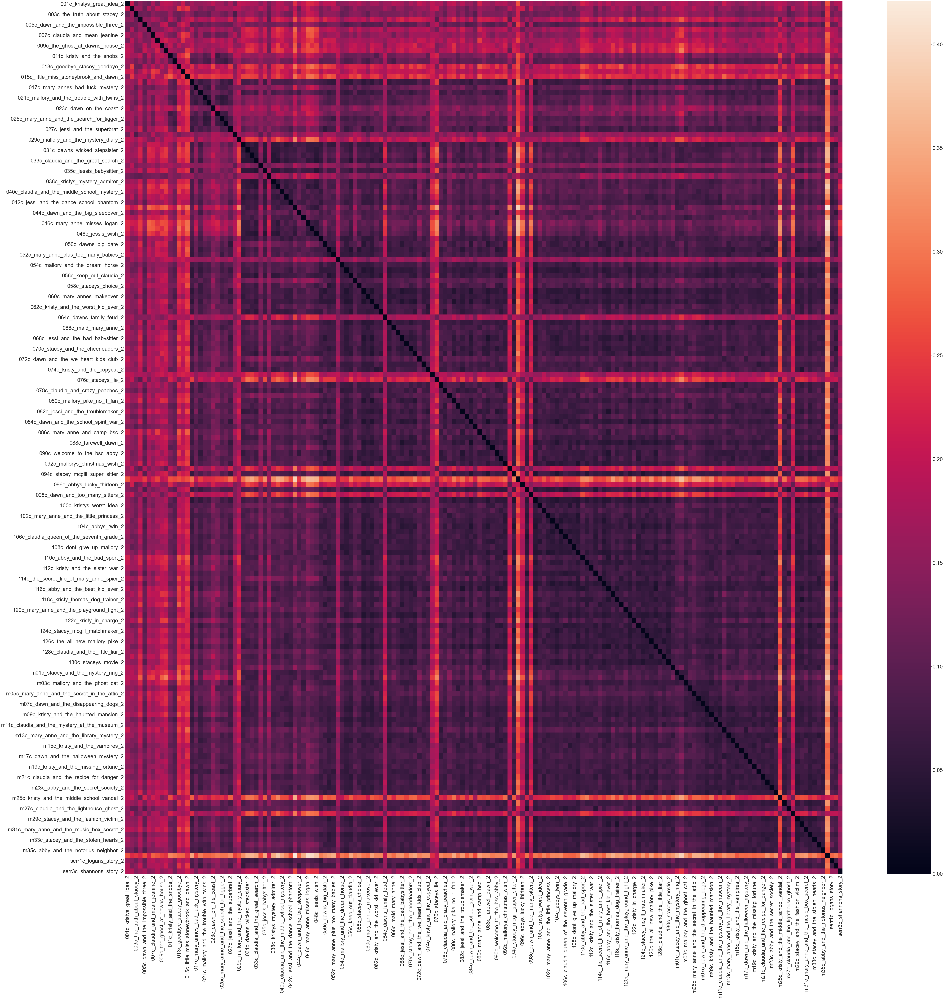

In [31]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(ch2_cosine_freq)
#Displays the image
plt.show()

Now **wait a minute!!** Why on earth do the full books look so much more similar than the chapter 2’s?! We **know** the chapter 2’s are more similar than the full books! *WTF is going wrong?!*

I was so irked at the direction this had gone that I entirely forgot about the typical mutual inquiry about well-being and all those social conventions at my next meeting with Mark. The first words out of my mouth, flying forth as soon as his audio connected on Zoom, were, “I tried to normalize the word counts and now the novels are more similar than the chapter 2’s **WHAT IS EVEN GOING ON HERE?!?!**”

And then I remembered--  as Kristy’s teacher, Mr. Redmont, would put it-- “*decorum*”, and managed to collect myself. “Also, hello! How are you?”

Mark was gracious and generous, as always. “I’m interested! Tell me more!” 

So I showed him, grumbling and annoyed as I pulled up the code and data. Mark thought about it. “I think you’re really comparing apples to oranges here. Changing word counts to word frequencies helps when your texts are different lengths, but, say, within an order of magnitude.” I stared, quizzically, into my laptop’s video camera. “So what I think is happening with your chapter 2’s is that they’re short enough that the difference between 10 and 13 instances of the word ‘the’ is going to make them look more ‘different’. And the same thing for every other word. With the end result being that the chapter 2’s look more different. But across the entirety of the novel, though, small differences in word frequencies even out. So they end up looking more similar.”

“Wait, so, there’s no way to compare chapters vs. whole books?” I asked.

“You could do that,” said Mark. “What you’d need to do is sample a chapter-2’s length of text from the set of all the words in a whole book. And then use that sample as the point of comparison.”

“Wait, what? If you randomly grab, say, 2,500 words from a novel, you’d be comparing chapter 2 vs. a text that doesn’t make any sense!”

Mark shrugged. “I mean, you could generate a text of chapter 2 length using a Markov chain if that would make you feel better,” he said, referencing a text-generation model where the probability of each word occurring depends only on the previous word generated. It’d probably have basically the same effect overall, but would be likely to make more sense to the human reader.

But that seemed like a task for a future BSC book. For now, though, a better point of comparison would be comparing how similar the chapter 2’s were, vs. other chapters, just like what we’d done earlier for cosine distance using word counts:

![Cosine distance using word frequency for chapters 1, 5, 9, and 15](images/dsc8_ch_1_5_9_15_freqs.png)

And clearly, even though the chapters are less similar than the books overall using this metric, the chapter 2’s are much more similar than other sets of chapters. So we’ve found the same overall result, but we’ve also saved ourselves from chasing false leads -- like the “difference” in Abby’s Portrait Collection book that only really have to do with text length. Not everything is as purple as everything else in this visualization, and there are still things we can follow up on. But we’ve leveled out the differences that are just about difference in length.

I think we’ve said all we can say about Euclidean and Cosine distance for this book, and how the results you get vary depending on how you count (or ratio) your words. It’s time to move on to a different method.

<div class="alert alert-block alert-info">
    <p><b>Note:</b> But the choose-your-own adventure book had other plans.</p>
    <p>At the top of the page you read: <em>Before moving on, it's time to close the loop about how much of your results had to do with the all the important similar words you dropped, and how much actually had to do with the frequency.</p></div>

## TF-IDF

As I mentioned before, TF-IDF stands for term frequency - inverse document frequency. TF-IDF tries to get at **distinctive** words. For each text, what are the words that set it apart from all the other texts you’re comparing against? To calculate TF-IDF, you don’t have to imagine 1000-dimensional space or anything like that. Term frequency is just how often the word occurs, divided by the total number of words in the text. Inverse document frequency is a way to reduce the importance of words that are high-frequency everywhere (like “the”) in order to surface the words that are high frequency in a particular text because they’re important. You calculate it using another concept from high school math: your old pal logarithm. The inverse document frequency for a word is: log_e(Total number of documents / Number of documents with term t in it).

The TF-IDF calculation is inherently comparative: it doesn’t make sense to run it on just one text, if you’re looking for what’s unique about a text in relation to other texts. But the output we get from TF-IDF is a list of words and numerical values, which isn’t something we can use to visualize a comparison of the texts, the way we could with the output of the vectorizer we used to plot points in 1000-dimensional space. We *can* use the TF-IDF calculations for each word in our vectorizer instead of simple word counts, which will generate a different set of points for each text, and from there we can use Euclidean or Cosine distance. But before we go there, let’s take a look at what we get out of the TF-IDF calculation, using our full-text corpus (not just the chapter 2s).

The word “baby-sitters” is going to appear in most or all of the books (maybe not California Diaries). On the other hand, the word “Lowell” (the surname of the racist family in BSC #56: *Keep Out, Claudia!*) only occurs in two books: *Keep Out, Claudia!* and BSC #3: *The Truth About Stacey* (where “Lowell” actually refers to a different person, Lowell Johnston). Lowell Johnston is only mentioned twice in *The Truth About Stacey*, so it’s still not going to get a high TF-IDF score in that book (it comes in #103 with a score of 10.64). But in *Keep Out, Claudia!*, Lowell appears a lot, and that number isn’t scaled down much at all because it only occurs in two books. So it ends up getting the highest TF-IDF score for that book, 707.82. This is a large score, more similar to characters in “very special episodes” who appear in just one book, like Whitney (the girl with Down’s Syndrome who Dawn babysits in BSC #77: *Dawn and Whitney, Friends Forever*).

TF-IDF is one approach to getting at what a text is “about” -- more straightforward to understand and faster to calculate than topic modeling. But especially working with a corpus of fiction, you’ll probably need to weed out the character names -- either by pre-processing the text to remove them, or looking beyond the first few highest-scoring terms. (If anything, we’re getting fewer high-scoring character names than you’d expect in most fiction. The major characters occur frequently enough that they get weighted down, like words like “the” and “is”.) 

Let's go back to the directory with the full texts:

In [32]:
filedir = '/Users/qad/Documents/dsc_corpus_clean'
os.chdir(filedir)

In [33]:
# Use the glob library to create a list of file names, sorted alphabetically
# Alphabetical sorting will get us the books in numerical order
filenames = sorted(glob.glob("*.txt"))
# Parse those filenames to create a list of file keys (ID numbers)
# You'll use these later on.
filekeys = [f.split('/')[-1].split('.')[0] for f in filenames]

# Create a CountVectorizer instance with the parameters you need
vectorizer = TfidfVectorizer(input="filename", stop_words=None, use_idf=True, norm=None, max_features=1000)
# Run the vectorizer on your list of filenames to create your wordcounts
# Use the toarray() function so that SciPy will accept the results
transformed_documents = vectorizer.fit_transform(filenames)
transformed_documents_as_array = transformed_documents.toarray()

The code from the Programming Historian tutorial generates a CSV file for each text, showing the TF-IDF value of each word. (You can find all these CSV files [in the GitHub repo for this book](https://github.com/datasittersclub/dsc8).)

In [34]:
# construct a list of output file paths using the previous list of text files the relative path for tf_idf_output
output_filenames = [str(txt_file).replace(".txt", ".csv") for txt_file in filenames]

# loop each item in transformed_documents_as_array, using enumerate to keep track of the current position
for counter, doc in enumerate(transformed_documents_as_array):
    # construct a dataframe
    tf_idf_tuples = list(zip(vectorizer.get_feature_names(), doc))
    one_doc_as_df = pd.DataFrame.from_records(tf_idf_tuples, columns=['term', 'score']).sort_values(by='score', ascending=False).reset_index(drop=True)

    # output to a csv using the enumerated value for the filename
    one_doc_as_df.to_csv(output_filenames[counter])

For BSC #54: *Mallory and the Dream Horse*, the top three terms are Nina (a little girl involved in the book’s babysitting sub-plot), Pax (the horse Mallory rides), and Lauren (Mallory’s equitation instructor), but by themselves they don’t help much with classifying this text. If you look in the top 10, though, you’ve got riding (#5), horse (#6), and horses (#8). In the top 25, there are lessons (#13), saddle (#15), riders (#17), reins (#18), stable (#19), canter (#21), and bridle (#25). It’s looking pretty horsey in here. 

In BSC #57: *Dawn Saves the Planet*, we’ve got recycling (#2), planet (#5), ecology (#7), pollution (#10), garbage (#11), recycle (#12), styrofoam (#13), recycled (#20), and carton (#25). 

BSC #110: *Abby and the Bad Sport* has coach (#3), soccer (#4), goal (#7), goalie (#8), players (#13), field (#15), referee (#17), defense (#18), cleats (#20), player (#21), kickers (#23), and benched (#24). You might not get the bad sportsmanship out of this, but there’s clearly some soccer afoot. 

What about books with a less obvious theme? There are some other terms that might throw you off, but you could probably come to the conclusion that art plays a meaningful role in BSC #12: *Claudia and the New Girl* with sculpture (#4), sculpt (#5), portfolio (#12), gallery (#22), ... despite hydrant (#15), vacuum (#19), and inanimate (#20). Indeed, the aforementioned new girl is into art, just like Claudia. 

If I were thinking of some distinctive words for BSC #87: *Stacey and the Bad Girls*, what would come to mind would be “shoplifting”, “concert”, “alcohol”, and “wine”. But the top 25 terms are almost all names -- including the band whose concert they go see (#7 U4Me) and the department store where the shoplifting takes place (#10 Bellair). There are also trains (#19) and escalator (#24). “Concert” does the best of my terms at #40. “Alcohol” is #80, between “camera” and “rosebud”. “Shoplift” is #118, between “bikes” and “creature”. And “wine” is down at #1002, in the company of “sniffle” and “bees”. So don’t get too comfortable with the assumption that TF-IDF will get you to basically the same set of terms that a human would think of. Plot salience and distinctive content aren’t the same as distinctive frequency distribution.

BSC #83: *Stacey vs. the BSC* features Stacey being duplicitous, along with the inter-babysitter drama that ultimately leads to the misbehavior described above for BSC #87, but you can’t see it in the top 25 terms, which feature a lot of names, various instances of onomatopoeia (“clack”, “clomp”, and “plink”), piano, fiesta, talent, twinkle, recital, cheese, and jukebox. There’s something to this: Dawn hides behind a jukebox spying on Stacey after she sneaks out on a date. And Charlotte plays the piano at the BSC talent show. Score three for TF-IDF! Even if it’s fixating on objects, at least they’re plot-significant objects. So what’s up with the cheese? I don’t have a good explanation, but it comes up a lot, between Jamie’s macaroni and cheese, extra pepperoni and cheese on a pizza, multiple references to cream cheese, cheese and crackers, a fiesta burger (there’s the “fiesta” from our TF-IDF results) with melted cheese… maybe ghostwriter Peter Lerangis had a cheese craving while writing it?

### TF-IDF for text comparison

Close-reading a distant reading method as a proxy for looking at the “topic” of individual texts is one way you can use the TF-IDF output. But you can also use it to compare texts at scale. You can also substitute in the TF-IDF vectorizer (with the IDF turned **on** this time) as your vectorizer of choice when trying out the Euclidean and cosine distance. 

The TF-IDF vectorizer has some optional parameters for dropping words. You can drop words that appear in too many documents with max_df. So `max_df = 0.9` means “ignore all words that appear in more than 90% of the documents”, or you can give it a specific number of documents with `max_df = 100`, for “ignore all words that appear in more than 100 documents”. You can get rid of words that appear too infrequently with min_df (e.g. `min_df = 0.1` means “ignore all words that appear in less than 10% of the documents”.) In this case, we’ll keep everything by not using those parameters, but you can play with them with your own corpora to see how it impacts your result to remove super-high frequency words (which, in the Baby-Sitters Club corpus, would get rid of both words like “the” and “a”, and the main characters’ names) or super-low frequency words (like the names of characters in the “very special episode” books.)

So let's do Euclidean and cosine distance using the TF-IDF vectorizer with IDF set to true, and see how it compares to using the count vectorizer, and using term frequency without IDF enabled.

<div class="alert alert-block alert-warning">
<b>Note:</b> If this were a horror-themed choose-your-own-adventure book, you might read something like this: <em>If only you could hear the screaming voices of the readers as you write this description of max_df. "CHECK YOUR CODE, YOU MADE THIS MISTAKE WITH YOUR FIRST EUCLIDEAN AND COSINE DISTANCE EXAMPLES!" But you cannot hear them. And so you remain ignorant of this fact for a few weeks longer. Turn the page..."</em>
</div>

In [35]:
tfidf_comparison_output_euclidean = pd.DataFrame(squareform(pdist(transformed_documents_as_array, metric='euclidean')), index=filekeys, columns=filekeys)
tfidf_comparison_output_euclidean

,000c_the_summer_before,001c_kristys_great_idea,002c_claudia_and_the_phantom_phone_calls,003c_the_truth_about_stacey,004c_mary_anne_saves_the_day,005c_dawn_and_the_impossible_three,006c_kristys_big_day,007c_claudia_and_mean_jeanine,008c_boy_crazy_stacey,009c_the_ghost_at_dawns_house,...,m36c_kristy_and_the_cat_burglar,pc1c_staceys_book,pc2c_claudias_book,pc3c_dawns_book,pc4c_mary_annes_book,pc5c_kristys_book,pc6c_abbys_book,serr1c_logans_story,serr2c_logan_bruno_boy_babysitter,serr3c_shannons_story
000c_the_summer_before,0.000000,1713.377124,1612.664014,1525.489173,1453.845926,1570.101303,1604.147402,1847.247725,1800.437885,1710.247038,...,1807.055544,1576.812993,1524.863481,1841.737653,1655.444614,1951.887865,2226.032081,1852.239496,1998.037080,1618.645066
001c_kristys_great_idea,1713.377124,0.000000,656.876129,693.424693,731.237464,833.934799,592.260494,807.904332,666.805535,700.374581,...,793.715920,970.020362,764.818214,823.158470,820.134900,742.132204,1121.810769,612.029801,692.573773,678.874266
002c_claudia_and_the_phantom_phone_calls,1612.664014,656.876129,0.000000,654.199535,624.772553,768.131077,684.948211,826.635694,701.590667,561.214764,...,765.810528,933.606450,711.930147,794.356012,759.672601,845.750393,1247.749650,656.836566,731.084665,678.342019
003c_the_truth_about_stacey,1525.489173,693.424693,654.199535,0.000000,657.986068,868.969005,765.823335,896.167881,833.564880,805.355785,...,929.845534,840.377792,825.819142,904.715197,863.168246,955.456784,1257.747669,811.001693,903.973220,781.667999
004c_mary_anne_saves_the_day,1453.845926,731.237464,624.772553,657.986068,0.000000,809.385573,755.198772,810.354784,848.343456,788.580283,...,940.317742,912.258691,743.237317,870.767868,756.292327,948.797634,1290.469268,768.933180,907.305837,705.113058
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pc5c_kristys_book,1951.887865,742.132204,845.750393,955.456784,948.797634,1075.300399,801.210096,937.559093,700.968345,756.699179,...,788.909197,847.675280,698.988424,531.788097,593.998782,0.000000,897.519505,557.059034,550.384043,663.065114
pc6c_abbys_book,2226.032081,1121.810769,1247.749650,1257.747669,1290.469268,1380.230234,1163.994242,1211.355418,1075.755779,1150.326653,...,1171.521844,1201.992446,1119.228644,960.208555,1076.537478,897.519505,0.000000,1004.879762,998.848888,1028.663383
serr1c_logans_story,1852.239496,612.029801,656.836566,811.001693,768.933180,905.439562,686.409319,849.635862,529.782108,590.123503,...,732.222472,905.294036,685.926803,639.025930,698.016291,557.059034,1004.879762,0.000000,380.573170,595.515698
serr2c_logan_bruno_boy_babysitter,1998.037080,692.573773,731.084665,903.973220,907.305837,1000.733519,799.570264,907.885413,624.207563,662.355458,...,737.885533,966.952976,817.489597,683.566913,731.316018,550.384043,998.848888,380.573170,0.000000,710.167240


In [36]:
tfidf_comparison_output_euclidean.to_csv('tfidf_comparison_output_euclidean.csv')

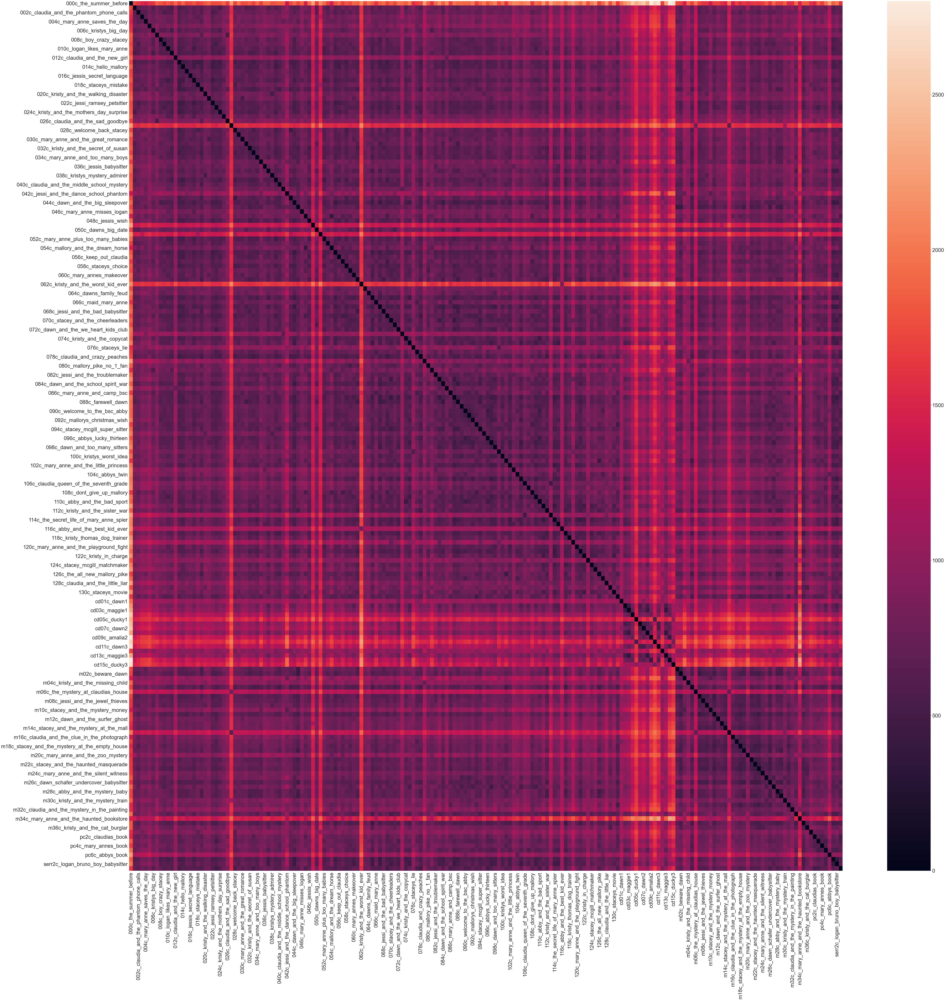

In [37]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(tfidf_comparison_output_euclidean)
#Displays the image
plt.show()

In [38]:
tfidf_comparison_output_cosine = pd.DataFrame(squareform(pdist(transformed_documents_as_array, metric='cosine')), index=filekeys, columns=filekeys)
tfidf_comparison_output_cosine

,000c_the_summer_before,001c_kristys_great_idea,002c_claudia_and_the_phantom_phone_calls,003c_the_truth_about_stacey,004c_mary_anne_saves_the_day,005c_dawn_and_the_impossible_three,006c_kristys_big_day,007c_claudia_and_mean_jeanine,008c_boy_crazy_stacey,009c_the_ghost_at_dawns_house,...,m36c_kristy_and_the_cat_burglar,pc1c_staceys_book,pc2c_claudias_book,pc3c_dawns_book,pc4c_mary_annes_book,pc5c_kristys_book,pc6c_abbys_book,serr1c_logans_story,serr2c_logan_bruno_boy_babysitter,serr3c_shannons_story
000c_the_summer_before,0.000000,0.049702,0.054073,0.051052,0.042593,0.066249,0.047594,0.084053,0.054140,0.055126,...,0.078758,0.052050,0.025529,0.050768,0.039348,0.039441,0.134936,0.039834,0.054325,0.033089
001c_kristys_great_idea,0.049702,0.000000,0.041635,0.040160,0.043012,0.055829,0.034892,0.071974,0.050777,0.053545,...,0.068351,0.091338,0.061610,0.078550,0.074399,0.057600,0.151661,0.040424,0.048307,0.050714
002c_claudia_and_the_phantom_phone_calls,0.054073,0.041635,0.000000,0.038151,0.033520,0.049937,0.045442,0.067641,0.045910,0.030220,...,0.057745,0.081921,0.049582,0.058456,0.056754,0.056046,0.160539,0.032136,0.034044,0.044850
003c_the_truth_about_stacey,0.051052,0.040160,0.038151,0.000000,0.037266,0.063910,0.052678,0.072323,0.058126,0.057566,...,0.078612,0.063166,0.061440,0.067455,0.066535,0.063049,0.143516,0.045493,0.052056,0.053615
004c_mary_anne_saves_the_day,0.042593,0.043012,0.033520,0.037266,0.000000,0.054919,0.049548,0.055513,0.057334,0.052644,...,0.077906,0.073005,0.047290,0.057083,0.047145,0.055903,0.146569,0.033976,0.047257,0.040245
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pc5c_kristys_book,0.039441,0.057600,0.056046,0.063049,0.055903,0.079451,0.051951,0.098401,0.059321,0.055968,...,0.061025,0.050849,0.038389,0.035875,0.029800,0.000000,0.125509,0.043983,0.047927,0.040212
pc6c_abbys_book,0.134936,0.151661,0.160539,0.143516,0.146569,0.166886,0.142048,0.175624,0.151161,0.154212,...,0.158685,0.140245,0.136574,0.127076,0.136553,0.125509,0.000000,0.146407,0.155288,0.122145
serr1c_logans_story,0.039834,0.040424,0.032136,0.045493,0.033976,0.054189,0.040279,0.081729,0.034173,0.034312,...,0.056283,0.072282,0.044419,0.054464,0.053285,0.043983,0.146407,0.000000,0.019467,0.036182
serr2c_logan_bruno_boy_babysitter,0.054325,0.048307,0.034044,0.052056,0.047257,0.062007,0.051839,0.091300,0.045317,0.038675,...,0.051081,0.077285,0.061465,0.062424,0.053968,0.047927,0.155288,0.019467,0.000000,0.048875


In [39]:
tfidf_comparison_output_cosine.to_csv('tfidf_comparison_output_cosine.csv')

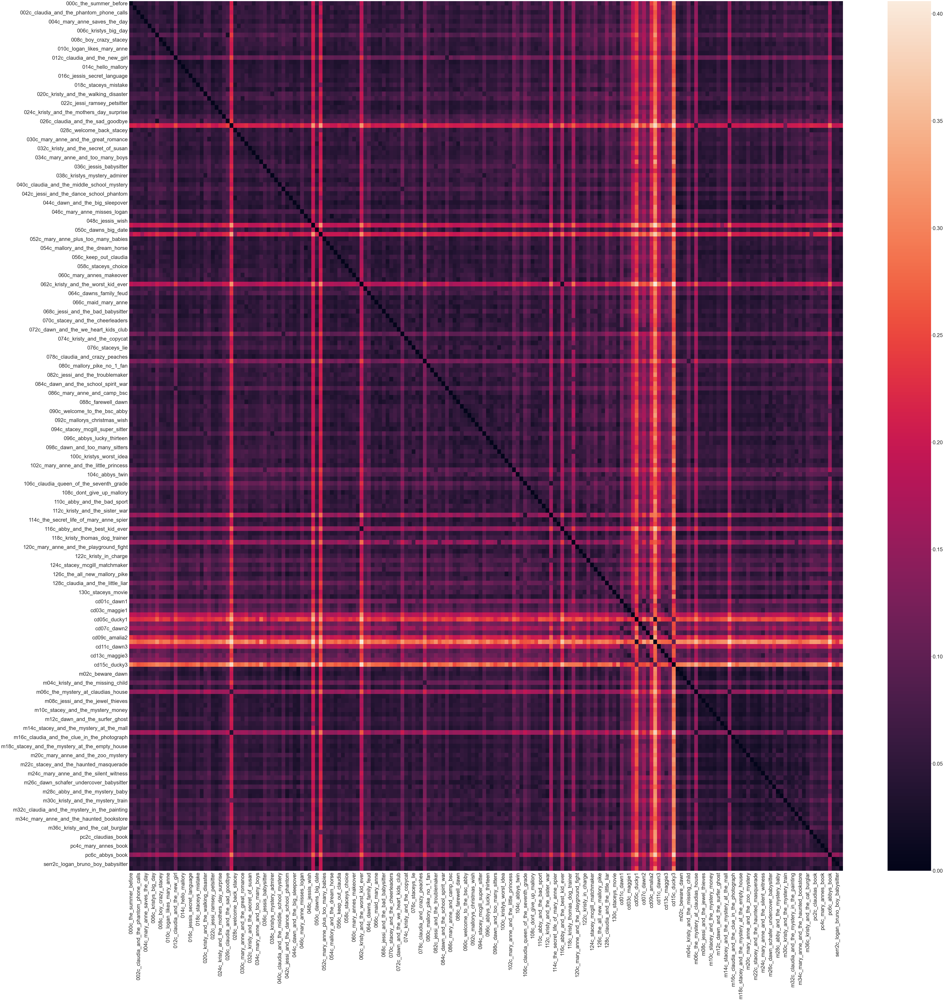

In [40]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(tfidf_comparison_output_cosine)
#Displays the image
plt.show()

There’s less difference between the Euclidean and cosine distance when using a TF-IDF vectorizer (that actually uses the “-IDF” in “TF-IDF”) than the word count vectorizer. So what happens when we try to run cosine distance using TF-IDF on chapter 2's?

In [41]:
ch2dir = '/Users/qad/Documents/dsc_chapters/ch2'
os.chdir(ch2dir)

In [42]:
# Use the glob library to create a list of file names, sorted alphabetically
# Alphabetical sorting will get us the books in numerical order
filenames = sorted(glob.glob("*.txt"))
# Parse those filenames to create a list of file keys (ID numbers)
# You'll use these later on.
filekeys = [f.split('/')[-1].split('.')[0] for f in filenames]

# Create a CountVectorizer instance with the parameters you need
vectorizer = TfidfVectorizer(input="filename", stop_words=None, use_idf=True, norm=None, max_features=1000)
# Run the vectorizer on your list of filenames to create your wordcounts
# Use the toarray() function so that SciPy will accept the results
ch2_tfidf = vectorizer.fit_transform(filenames).toarray()

In [43]:
ch2_cosine_tfidf = pd.DataFrame(squareform(pdist(ch2_tfidf, metric='cosine')), index=filekeys, columns=filekeys)
ch2_cosine_tfidf

,001c_kristys_great_idea_2,002c_claudia_and_the_phantom_phone_calls_2,003c_the_truth_about_stacey_2,004c_mary_anne_saves_the_day_2,005c_dawn_and_the_impossible_three_2,006c_kristys_big_day_2,007c_claudia_and_mean_jeanine_2,008c_boy_crazy_stacey_2,009c_the_ghost_at_dawns_house_2,010c_logan_likes_mary_anne_2,...,m30c_kristy_and_the_mystery_train_2,m31c_mary_anne_and_the_music_box_secret_2,m32c_claudia_and_the_mystery_in_the_painting_2,m33c_stacey_and_the_stolen_hearts_2,m34c_mary_anne_and_the_haunted_bookstore_2,m35c_abby_and_the_notorius_neighbor_2,m36c_kristy_and_the_cat_burglar_2,serr1c_logans_story_2,serr2c_logan_bruno_boy_babysitter_2,serr3c_shannons_story_2
001c_kristys_great_idea_2,0.000000,0.246074,0.151527,0.188421,0.173291,0.172800,0.224098,0.181280,0.236114,0.247249,...,0.213941,0.254544,0.186659,0.224199,0.203184,0.165524,0.612455,0.200885,0.223696,0.296085
002c_claudia_and_the_phantom_phone_calls_2,0.246074,0.000000,0.199677,0.205898,0.160327,0.240095,0.176995,0.236811,0.224528,0.221839,...,0.201332,0.243469,0.169802,0.193133,0.190436,0.163584,0.592890,0.178847,0.163631,0.295182
003c_the_truth_about_stacey_2,0.151527,0.199677,0.000000,0.158336,0.168554,0.171509,0.187947,0.182646,0.173739,0.174705,...,0.191784,0.219820,0.158270,0.178785,0.163439,0.126376,0.598587,0.157084,0.179818,0.245696
004c_mary_anne_saves_the_day_2,0.188421,0.205898,0.158336,0.000000,0.202878,0.211559,0.230825,0.221566,0.183476,0.175910,...,0.248089,0.268533,0.212441,0.236738,0.225911,0.198259,0.592314,0.206621,0.239792,0.276399
005c_dawn_and_the_impossible_three_2,0.173291,0.160327,0.168554,0.202878,0.000000,0.220103,0.168376,0.190539,0.252589,0.257517,...,0.157010,0.206133,0.143678,0.158212,0.165593,0.126658,0.615353,0.152453,0.155432,0.294697
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
m35c_abby_and_the_notorius_neighbor_2,0.165524,0.163584,0.126376,0.198259,0.126658,0.197771,0.169933,0.198773,0.193097,0.205686,...,0.112034,0.116003,0.089299,0.090349,0.082690,0.000000,0.606522,0.103207,0.091476,0.249500
m36c_kristy_and_the_cat_burglar_2,0.612455,0.592890,0.598587,0.592314,0.615353,0.594343,0.622589,0.618557,0.607806,0.601490,...,0.645133,0.654663,0.628074,0.636853,0.617428,0.606522,0.000000,0.622800,0.629522,0.643610
serr1c_logans_story_2,0.200885,0.178847,0.157084,0.206621,0.152453,0.241002,0.234209,0.220610,0.228961,0.242113,...,0.129060,0.154466,0.115005,0.121168,0.150209,0.103207,0.622800,0.000000,0.096860,0.266514
serr2c_logan_bruno_boy_babysitter_2,0.223696,0.163631,0.179818,0.239792,0.155432,0.234046,0.214840,0.235139,0.219557,0.249190,...,0.116504,0.120264,0.097254,0.110505,0.101533,0.091476,0.629522,0.096860,0.000000,0.263784


In [44]:
ch2_cosine_tfidf.to_csv('ch2_tfidf.csv')

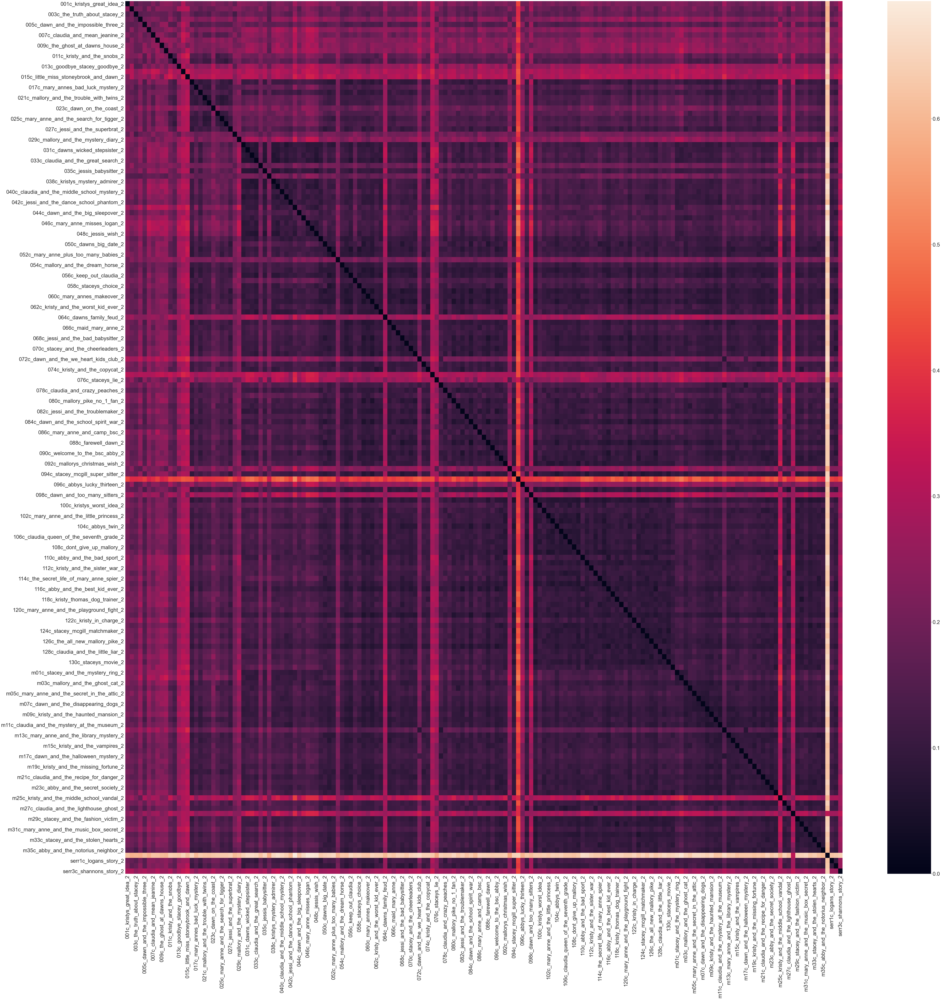

In [45]:
#Defines the size of the image
plt.figure(figsize=(100, 100))
#Increases the label size so it's more legible
sns.set(font_scale=3)
#Generates the visualization using the data in the dataframe
ax = sns.heatmap(ch2_cosine_tfidf)
#Displays the image
plt.show()

Differences in chapter length do still matter (longer chapters probably have more distinct words, each of which will have a value that will go into the calculation of the overall score for that chapter). That said, length matters lot less than with the word count vectorizer... and a lot more than when you're using word *frequencies*. What this gets us, mostly, is a fairly clear picture of when chapter 2s morph into the Home of the Tropes, and a very clear picture of when those tropes occur in chapter 3 rather than chapter 2 (the super-light lines in the otherwise-dark visualization).

## What does this tell us about chapter 2?

Text distance metrics and things like TF-IDF are at their most useful when you’ve got a very large corpus, and/or one that you don’t know well. Imagine you’ve never read a Baby-Sitters Club book (perhaps that’s not hard for some of you!) and someone hands you a corpus of 250 text files and tells you to go find something interesting about them. Without having to read them at all, you could discover the things we’ve talked about here. The California Diaries sub-series is really different! There’s something weird going on with these super-repetitive chapter 2s! 

But before you get too excited, it’s worth checking with someone who **does** know the corpus well, if such a person exists. (With something like Twitter data, there probably isn’t anyone who’s read every tweet in the corpus you’ve collected, but if your data is collected based on a hashtag, you might be able to find someone to talk to from the community that uses that hashtag.) In the case of the Baby-Sitters Club, anyone who’s read the books can tell you that the chapter 2 phenomenon is well-known. So what new insights are these distance metrics providing?

To be honest, in the case of chapter 2s, I think the answer is “not much”. As much as I love trying new methods to see what will happen, I should’ve seen where this was going and been more confident in the choice I’d made to use Scott’s 6-gram tool as the way to tackle the chapter 2 question. *That* approach got us something new, surfacing (albeit with some noise) a set of tropes repeated through the corpus, and showing that the highest amounts of repetition tend to happen among the works of a single ghostwriter. It’s not a shock, but it feels like some kind of contribution -- and more of a contribution than just quantifying how much more similar the chapter 2s are compared to the other chapters.

We might be able to do something with these text comparison methods in the future -- like using them as a jumping-off point for exploring the clusters around books 30-48 and 83-101. But sometimes you discover that you’ve spent a lot of time trying something that’s the wrong tool for the job. Or, as this DH choose-your-own adventure book might conclude, “*You close the Jupyter notebook. You may not have any meaningful results, but you’ve written some code that works, and you can use it another day, for another project. To be continued…*”

You probably close the book at that point, feeling dissatisfied with your reading experience. 

But sometimes, in frustration and annoyance, you keep flipping pages even after the book ends. And sometimes, in those very last pages of your choose-your-own-adventure book, there’s an advertisement for a forthcoming book that catches your eye with promises of future adventures. And the same thing can happen in DH, when a collaborator points out something you’ve missed.

I wasn’t happy with how this DSC book ended, but I was resigned to ending it with a shrug. Sometimes projects work out that way. But when I ran it by our Associate Data-Sitter to make sure I hadn’t missed anything, Mark managed to convince me to keep turning pages: “Look, this is really the point before things get interesting: you’ve established a baseline that shows computational methods, based only on relative word frequency, can replicate an important aspect of the book that is evident at the level of reading, the ‘chapter 2 phenomenon’.”

He had a point -- I hadn’t really thought about the significance of what it meant to be able to computationally find things we already know. The response doesn’t need to be, “Yeah, we knew that” but maybe instead it can be, “Cool -- let’s add the ‘chapter 2 phenomenon’ to the list of things our current computational methods really can allow us to find in texts, unlike other things we’re still working out computationally.

“The exciting stuff is what happens next,” Mark added. “What features, in particular, are responsible for these similarities? And do these features change over time or between different groups of books? Also, you could move the same way to visualizations: what about a network where each chapter 2 is a node, and you connect it to the most similar other chapter 2’s based on a similarity threshold? You could easily wind up showing again that this varies by ghostwriter. Or you could find something else, which would be super cool. I’d be most interested in the chapter 2’s that were definitely chapter 2’s (that is, they took part in the same convention, not where chapter 3 is actually “chapter 2”), but whose language was LEAST similar – what are they doing differently?”

And so the very last page of this DH choose-your-own-adventure book reads: *You add a handful of new research questions to your list of ideas for your corpus. They already number too many for you to get through in a decade, even with the help of six friends. But it doesn’t matter. Your brain is whirring away at trying to piece together the code for how to tackle this one. You know it’ll fuel your insomnia, but for this moment, you don’t mind. Your research question is fun again!*

## Suggested Citation

Suggested citation: Dombrowski, Quinn. “DSC #8: Text-Comparison-Algorithm-Crazy Quinn.” Jupyter Notebook version. *The Data-Sitters Club*, October 20, 2020. https://datasittersclub.github.io/site/dsc8/.